In [12]:
import healpy as hp
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib.colors import ListedColormap
import sys
from pathlib import Path
import glob
import numpy as np
from astropy.io import fits
from astropy.table import Table, join
import pickle
import cmasher as cmr
import matplotlib.colors as colors

In [13]:
plt.rcParams['font.family'] = 'serif'
plt.rcParams['text.usetex'] = True            # use LaTeX for all text handling
plt.rcParams['mathtext.fontset'] = 'cm'       # use Computer Modern font,  matching LaTeX default

plcmap=ListedColormap(np.loadtxt('/mn/stornext/u3/raelynsu/code/plotting/planck_cmap.dat')/256)
def_kwargs={'cmap':plcmap}

# Set recommended parameters for single-column figures
plt.rcParams['figure.dpi']= 300
plt.rcParams['figure.figsize'] = 3.2, 2.0   # set some senisible width and height for your medium

plt.rcParams['font.size'] = 8               # font size used as 'medium'
plt.rcParams['axes.labelsize'] = 'medium'
plt.rcParams['legend.fontsize'] = 'medium'

plt.rcParams['savefig.format'] = 'pdf'      # pdf and svg are vector graphics, which ensure your fonts don't 
plt.rcParams['savefig.bbox'] = 'tight'      # 'tight': no extra white space around the figure
plt.rcParams['savefig.pad_inches'] = 0.02   # padding used when bbox is set to 'tight'


plt.rcParams['xtick.direction'] = 'in'
# Set y-axis major and minor ticks to point inwards
plt.rcParams['ytick.direction'] = 'in'

In [3]:
h=6.62607015e-34 #m2 kg s-1
kb=1.380649e-23 #m2 kg s-2 K-1
hkb=(h/kb)*1e9 #4.8e-11,  K GHz-1

In [4]:
def get_onepix(filename):
    with fits.open(filename,memmap=True) as hdul:
        val=hdul[1].data[0][0][0]
    return val


def apply_mask(map,mask):
    mapout=map*1
    mapout[mask==0]=hp.UNSEEN
    return mapout


def calcCorr(map1,map2,mask=None):
    if mask is None:
        mask=np.ones_like(map1)
    amap1=np.mean(map1[mask==1])
    smap1=np.std(map1[mask==1])
    amap2=np.mean(map2[mask==1])
    smap2=np.std(map2[mask==1])
    corrMap=np.zeros_like(map1)
    corrMap[mask==1]=((map1[mask==1]-amap1)/smap1)*((map2[mask==1]-amap2)/smap2)
    corr=sum(corrMap[mask==1])/(len(corrMap[mask==1])-1)
    return corr, corrMap

#https://en.wikipedia.org/wiki/Pearson_correlation_coefficient



def downgrade(map,oldbeam,newbeam,newres):
    alm=hp.map2alm(map,use_pixel_weights=True)
    oldres=hp.get_nside(map)
    lmax=4*newres-1
    nb=hp.gauss_beam(np.deg2rad(newbeam/60),lmax=lmax)
    ob=hp.gauss_beam(np.deg2rad(oldbeam/60),lmax=lmax)
    alm_n=hp.almxfl(alm,nb/(ob))
    map_out=hp.alm2map(alm_n,newres)
    return map_out

def downgrade_ud(map,oldbeam,newbeam,newres):
    alm=hp.map2alm(map,use_pixel_weights=True)
    oldres=hp.get_nside(map)
    lmax=3*oldres-1  
    nb=hp.gauss_beam(np.deg2rad(newbeam/60),lmax=lmax)
    ob=hp.gauss_beam(np.deg2rad(oldbeam/60),lmax=lmax)
    alm_n=hp.almxfl(alm,nb/(ob))
    map_out=hp.alm2map(alm_n,oldres)
    mapfinal=hp.ud_grade(map_out,newres)
    return mapfinal


##TT correlation plots

def plotTT(map1,map2,labelx=None,labely=None,mask=None,**kwargs):
    # ax,fig=plt.subplot()
    if mask is None:
        mask=np.ones_like(map1,dtype=bool)
    plt.scatter(map1[mask==1],map2[mask==1],**kwargs)
    plt.xlabel(labelx)
    plt.ylabel(labely)
    plt.show()

In [5]:
###freg in GHz
def plotMBB(T,beta,amp,freqs,ref_freq=545,unit_conv=1):
    h=6.62607015e-34 #m2 kg s-1
    kb=1.380649e-23 #m2 kg s-2 K-1
    hkb=(h/kb)*1e9 #4.8e-11,  K GHz-1
    pref=hkb*ref_freq/T
    p=hkb*freqs/T
    sed=amp*(freqs/ref_freq)**(beta+1)*(np.exp(pref)-1)/(np.exp(p)-1)
    return sed*unit_conv

In [6]:
###make table

def generate_planck_table_latex(
    data,
    row_labels,
    col_headers,
    first_col="",
    col_units=None,
    caption="",
    label="tab:custom",
    digits=2,
    include_uncertainty=True
):
    """
    Generate a LaTeX table in Planck paper style.

    Parameters:
    - data: 2D list of values (or (value, error) tuples if include_uncertainty=True)
    - row_labels: list of strings for the first column (methods)
    - col_headers: list of column headers
    - first_col: first column label (optional)
    - col_units: list of units per column (optional)
    - caption: table caption
    - label: LaTeX label
    - digits: number of decimal digits
    - include_uncertainty: if True, expects (value, error) pairs in data

    Returns:
    - A string with LaTeX code
    """

    def format_cell(cell):
        if include_uncertainty and isinstance(cell, (tuple, list)) and len(cell) == 2:
            fmt = f"{{0:.{digits}f}} \\pm {{1:.{digits}f}}"
            return f"$ {fmt.format(*cell)} $"
        else:
            return f"$ {{0:.{digits}f}} $".format(cell)

    n_cols = len(col_headers)
    lines = []

    lines.append("\\begin{table}[tbp!]")
    lines.append("\\begingroup")
    lines.append("\\newdimen\\tblskip \\tblskip=5pt")
    lines.append("\\nointerlineskip")
    lines.append("\\vskip -3mm")
    lines.append("\\footnotesize")
    lines.append("\\setbox\\tablebox=\\vbox{")
    lines.append("   \\newdimen\\digitwidth")
    lines.append("   \\setbox0=\\hbox{\\rm 0}")
    lines.append("   \\digitwidth=\\wd0")
    lines.append("   \\catcode`*=\\active")
    lines.append("   \\def*{\\kern\\digitwidth}")
    lines.append("   \\newdimen\\signwidth")
    lines.append("   \\setbox0=\\hbox{+}")
    lines.append("   \\signwidth=\\wd0")
    lines.append("   \\catcode`!=\\active")
    lines.append("   \\def!{\\kern\\signwidth}")

    tab_format = "\\halign{\\tabskip 0pt "
    tab_format += "\\hbox to 1in{#\\leaderfil}\\tabskip 0pt&"
    tab_format += ("\\hfil#\\hfil\\tabskip 10pt&" * (n_cols - 1))
    tab_format += "\\hfil#\\hfil\\tabskip 0pt\\cr"
    lines.append(tab_format)

    # Headers
    lines.append("\\noalign{\\doubleline\\vskip 1pt}")
    
    if col_units:
        lines.append("\\omit\\hfil & " + " & ".join([f"!{h}" for h in col_headers]) + "\\cr")
        lines.append("\\omit\\hfil "+first_col+ " \\hfil& " + " & ".join([f"[{u}]" for u in col_units]) + "\\cr")
    else:
        lines.append("\\omit\\hfil "+first_col+ " \\hfil& " + " & ".join([f"!{h}" for h in col_headers]) + "\\cr")

    lines.append("\\noalign{\\vskip 4pt\\hrule\\vskip 6pt}")
    lines.append("\\noalign{\\vskip 3pt}")

    # Data rows
    for rlabel, row in zip(row_labels, data):
        formatted = [format_cell(cell) for cell in row]
        lines.append(f"{rlabel}& " + " & ".join(formatted) + "\\cr")
        lines.append("\\noalign{\\vskip 3pt}")

    lines.append("\\noalign{\\vskip 3pt\\hrule\\vskip 4pt}}}")
    lines.append("\\endPlancktable")
    lines.append("\\endgroup")
    lines.append(f"\\caption{{{caption}}}")
    lines.append(f"\\label{{{label}}}")
    lines.append("\\end{table}")

    return "\n".join(lines)


def generate_planck_table_latex2(
    data,
    row_labels,
    col_headers,
    first_col="",
    col_units=None,
    caption="",
    label="tab:custom",
    digits=2,
    include_uncertainty=True,
    total_width="\\linewidth",
    scale_first=2,
    scale_all=0.95
):
    """
    Generate a LaTeX table in Planck paper style., with alignment for minus signs 

    Parameters:
    - data: 2D list of values (or (value, error) tuples if include_uncertainty=True)
    - row_labels: list of strings for the first column (methods)
    - col_headers: list of column headers
    - first_col: first column label (optional)
    - col_units: list of units per column (optional)
    - caption: table caption
    - label: LaTeX label
    - digits: number of decimal digits
    - include_uncertainty: if True, expects (value, error) pairs in data

    Returns:
    - A string with LaTeX code
    """

    n_cols = len(col_headers)

    # Determine which columns contain negative values
    col_has_negative = [False] * n_cols
    for row in data:
        for i, cell in enumerate(row):
            value = cell[0] if (include_uncertainty and isinstance(cell, (tuple, list))) else cell
            if value < 0:
                col_has_negative[i] = True

    def format_cell(cell, col_index):
        if include_uncertainty and isinstance(cell, (tuple, list)) and len(cell) == 2:
            value, error = cell
            if value < 0:
                fmt = f"{{0:.{digits}f}} \\pm {{1:.{digits}f}}"
                return f"$ {fmt.format(value, error)} $"
            else:
                sign = "\\phantom{{-}}" if col_has_negative[col_index] else ""
                fmt = f"{sign}{{0:.{digits}f}} \\pm {{1:.{digits}f}}"
                return f"$ {fmt.format(value, error)} $"
        else:
            value = cell
            if value < 0:
                fmt = f"{{0:.{digits}f}}"
                return f"$ {fmt.format(value)} $"
            else:
                sign = "\\phantom{{-}}" if col_has_negative[col_index] else ""
                fmt = f"{sign}{{0:.{digits}f}}"
                return f"$ {fmt.format(value)} $"


    lines = []

    lines.append("\\begin{table}[tbp!]")
    lines.append("\\begingroup")
    lines.append("\\newdimen\\tblskip \\tblskip=5pt")
    lines.append("\\nointerlineskip")
    lines.append("\\vskip -3mm")
    lines.append("\\footnotesize")
    lines.append("\\setbox\\tablebox=\\vbox{")

    # tab_format = "\\halign{\\tabskip 0pt "
    # tab_format += "\\hbox to 1in{#\\leaderfil}\\tabskip 0pt&"
    # tab_format += ("\\hfil#\\hfil\\tabskip 10pt&" * (n_cols - 1))
    # tab_format += "\\hfil#\\hfil\\tabskip 0pt\\cr"
    

    # Compute column widths
    n_data_cols = len(col_headers)
    first_col_width = f"{scale_first*scale_all / (n_data_cols + scale_first):.4f}{total_width}"
    data_col_width = f"{1.0*scale_all / (n_data_cols + scale_first):.4f}{total_width}"

    tab_format = "\\halign{\\tabskip 0pt "
    tab_format += f"\\hbox to {first_col_width}{{#\\leaderfil}}\\tabskip 0pt&"
    tab_format += (f"\\hbox to {data_col_width}{{\\hfil#\\hfil}}\\tabskip 10pt&" * (n_data_cols - 1))
    tab_format += f"\\hbox to {data_col_width}{{\\hfil#}}\\tabskip 0pt\\cr"
    lines.append(tab_format)

    # Headers
    lines.append("\\noalign{\\doubleline\\vskip 1pt}")

    if col_units:
        lines.append(f"\\omit\\hbox to 1in{{{first_col}\\hfil}}& " + " & ".join([f"{h}" for h in col_headers]) + "\\cr")
        lines.append("\\omit\\hfil & " + " & ".join([f"[{u}]" for u in col_units]) + "\\cr")
    else:
        lines.append(f"\\omit\\hbox to 1in{{{first_col}\\hfil}}& " + " & ".join([f"{h}" for h in col_headers]) + "\\cr")

    lines.append("\\noalign{\\vskip 4pt\\hrule\\vskip 6pt}")
    lines.append("\\noalign{\\vskip 3pt}")

    # Data rows
    for rlabel, row in zip(row_labels, data):
        formatted = [format_cell(cell, i) for i, cell in enumerate(row)]
        lines.append(f"{rlabel}& " + " & ".join(formatted) + "\\cr")
        lines.append("\\noalign{\\vskip 3pt}")

    lines.append("\\noalign{\\vskip 3pt\\hrule\\vskip 4pt}}}")
    lines.append("\\endPlancktable")
    lines.append("\\endgroup")
    lines.append(f"\\caption{{{caption}}}")
    lines.append(f"\\label{{{label}}}")
    lines.append("\\end{table}")

    return "\n".join(lines)


In [7]:
#efficiency
def get_eff(map,res,cmb):
    if hp.get_nside(cmb)!=hp.get_nside(map):
        m=hp.ud_grade(map,hp.get_nside(cmb))
        m=(m-cmb)**2
    else:
        m=(map-cmb)**2
    temp=(m**2-res**2)/m**2
    # temp_m=np.ma.masked_array(temp,temp<0,fill_value=0)

    return np.sum(temp[temp>0])/len(temp[temp>0]), temp

In [8]:
#efficiency
def get_eff_dust(dust,res):
    m=(dust+res)**2
    temp=(m**2-res**2)/m**2
    # temp_m=np.ma.masked_array(temp,temp<0,fill_value=0)

    return np.sum(temp[temp>0])/len(temp[temp>0]), temp

In [10]:
# def get_eff_dustmap(dust_map,res):
#     if hp.get_nside(cmb)!=hp.get_nside(map):
#         m=hp.ud_grade(map,hp.get_nside(cmb))
#         m=(m-cmb)**2
#     else:
#         m=(map-cmb)**2
#     temp=(m**2-res**2)/m**2
#     # temp_m=np.ma.masked_array(temp,temp<0,fill_value=0)
#     return temp

In [12]:
# 200001000 1.0 2.62 17.8 1.5 1.7 18 1.75 30.0 1.85 10.3 1430.9708394271386 y
# 200001001 1.0 2.62 17.8 1.5 1.7 18 1.75 30.0 1.45 10.3 1815.7600419456767 y
# 200001002 1.0 2.62 17.8 1.5 1.7 18 1.75 30.0 2.25 10.3 1545.181739206265 y
# 200001003 1.0 2.62 17.8 1.5 1.7 18 1.75 30.0 1.85 14.3 1492.2611412554534 n
# 200001011 1.0 2.62 17.8 1.5 1.7 18 1.75 30.0 1.65 11.3 1477.7234234278344 y
# 200001012 1.0 2.62 17.8 1.5 1.7 18 1.75 30.0 2.05 11.3 1493.6376164664625 y
# 200001013 1.0 2.62 17.8 1.5 1.7 18 1.75 30.0 1.85 13.3 1465.904058345258 n
# 200001050 1.0 2.62 17.8 1.5 1.7 18 1.75 30.0 1.45 14.3 1510.088284212112 y
# 200001051 1.0 2.62 17.8 1.5 1.7 18 1.75 30.0 1.45 15.3 1491.0793712306568 y
# 200004000 1.0 2.62 17.8 1.5 1.7 18 1.75 30.0 1.85 12.3 1442.0919844195923 y

In [15]:
dust_fil='/mn/stornext/d22/cmbco_nobackup/raelynsu/grid_tests/grid_'
dust_names=['/dust_','/dust_cii_','/hotPAH_','/dust_Ha_']
nmend='c0001_k000002.fits'
fiducial=300000000

samp=2

plot_res=128
plot_sm=hp.nside2resol(plot_res)*180/np.pi*60*3
#HFI maps
data_folder='/mn/stornext/d23/cmbco/cg/hfi/data/'

In [16]:
dust_titles=['Cold dust', 'Hot dust','Near dust',r'$H_\alpha$ dust']
dust_titles_nl=['Cold \n dust', 'Hot \n dust','Near \n dust',r'$H_\alpha$ \n dust']
# dust_cmap=['Reds_r','Reds_r','Reds_r','Blues']
dust_cmap=['cmr.sunburst','cmr.sunburst','cmr.sunburst','cmr.freeze_r']
#maybe ["sunburst", "iceburn"],
dust_maxc=[500,500,300,0]
dust_minc=[0,0,20,-50]
dust_units=[r'$\mu \mathrm{K_{CMB}}$',r'$\mu \mathrm{K_{CMB}}$',r'$\mu \mathrm{K_{CMB}}$',r'$\mu \mathrm{K_{CMB}}$']
dust_sm=[5,5,10,10]
dust_resol=[4096,4096,2048,2048]

fg_titles=[r'$A_\mathrm{CO01}$',r'$A_\mathrm{CO21}$',r'$A_\mathrm{CO32}$',r'$A_\mathrm{ff}$',r'$A_\mathrm{CMB}$']
fg_titles_nl=[r'$A_\mathrm{CO01}$',r'$A_\mathrm{CO21}$',r'$A_\mathrm{CO32}$',r'$A_\mathrm{ff}$',r'$A_\mathrm{CMB}$']
fg_names=['co100','co217','co353','ff','cmb']
fg_cmap=["cmr.arctic","cmr.arctic","cmr.arctic",'cmr.freeze',plcmap]
fg_maxc=[1,1,1,5000,600]
fg_minc=[-1,-1,-1,-500,-600]
fg_units=['Kkm/s','Kkm/s','Kkm/s',r'$\mu \mathrm{K}_\mathrm{RJ}',r'$\mu \mathrm{K}_\mathrm{CMB}}$']

res_cmap=plcmap

In [17]:
##grid 
track_params_new=Table.read('/mn/stornext/u3/raelynsu/grid_tests/track_finalGrid.txt',format='ascii')
summary_stats_new=Table.read('/mn/stornext/u3/raelynsu/grid_tests/SummaryPlots/summary_stats_finalGrid.txt',format='ascii')
# params_new=join(track_params_new,summary_stats_new,keys='num')
params_new=track_params_new

In [18]:
##to get physical multiply by test_phys
test_phys=(params_new['pos_cent']=='y')
test_hot= ((params_new['num']>=300002000)*(params_new['num']<300003000)
          +(params_new['num']==300000000))
test_cold=((params_new['num']>=300001000)*(params_new['num']<300001000)
          +(params_new['num']>=200001000)*(params_new['num']<200005000)
          +(params_new['num']==300000000))
test_near=((params_new['num']>=300003000)*(params_new['num']<300004000)
          +(params_new['num']==300000000))
test_wham=((params_new['num']>=300004000)*(params_new['num']<300005000)
          +(params_new['num']==300000000))


In [19]:
freqs=np.asarray([100,143,217,353,545,857])
# Horn configurations
band_arr = [
    ['-1', '-2', '-3', '-4'],                           # 100 GHz
    ['-1', '-2', '-3', '-4', '-5', '-6', '-7'],         # 143 GHz
    ['-1', '-2', '-3', '-4', '-5', '-6', '-7', '-8'],   # 217 GHz
    ['-1', '-2', '-3', '-4', '-5', '-6', '-7', '-8'],   # 353 GHz
    ['-1', '-2', '-4'],                                 # 545 GHz
    ['-1', '-2', '-3', '-4']                            # 857 GHz
]

dfil=['_npipe_02048_fullres_full_T_zodicorr.fits',          #100
      '_npipe_02048_fullres_full_T_zodicorr.fits',          #143
      '_npipe_04096_fullres_full_T_zodicorr.fits',          #217
      '_npipe_04096_fullres_full_T_zodicorr_CIBcorr.fits',  #353
      '_npipe_04096_fullres_full_T_zodicorr_CIBcorr.fits',  #545
      '_npipe_04096_fullres_full_T_zodicorr_CIBcorr.fits']  #857
smooth=120 #arcmin
nmr='/res_'
nmd='map_planck_'
fil='_c0001_k'+str(samp).zfill(6)+'.fits'

In [21]:
##Template maps
#HI4PI map, nside 1024, beam 16.2
Himap=hp.read_map('/mn/stornext/u3/hke/data_dirbe/hke/raelyn/HI4PI_fwhm16p2_ns1024.fits')
Himap_plotres=downgrade(Himap, 16.2,plot_sm,plot_res)

#firas cii, 158 μm line
firas_mask=hp.read_map(data_folder+'FIRAS_mask.fits')
firas_cii=hp.read_map(data_folder+'CII_FIRAS_v1_n16.fits')
firas_cii_masked=np.ma.masked_array(firas_cii,mask=1-firas_mask)#np.where(firas_mask,firas_cii,hp.UNSEEN)

pah_init3=hp.read_map(data_folder+'init_edenhofer_545_uKrj_n2048_v1.fits')

ha_init2=hp.read_map(data_folder+'init_WHAM_Ha_545_uKrj_n2048_v1.fits')


dame_co=hp.read_map(data_folder+'lambda_wco_dht2001.fits') #nside 512
dame_mask=dame_co!=0
dame_co_masked=dame_co*1
dame_co_masked[dame_co==0]=hp.UNSEEN

COMMEN    map, W(CO), was obtained from the CfA Millimeter Wave Group website    [astropy.io.fits.card]


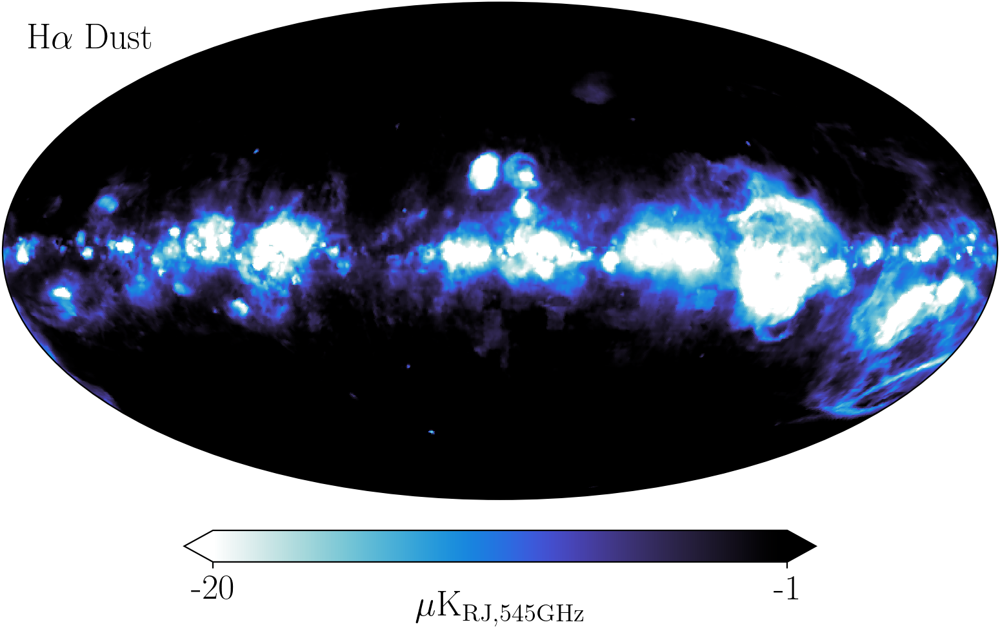

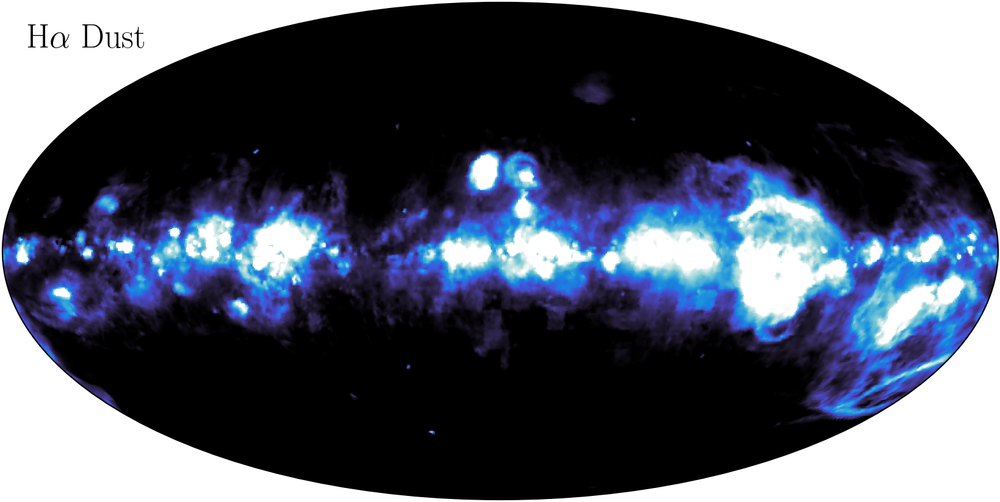

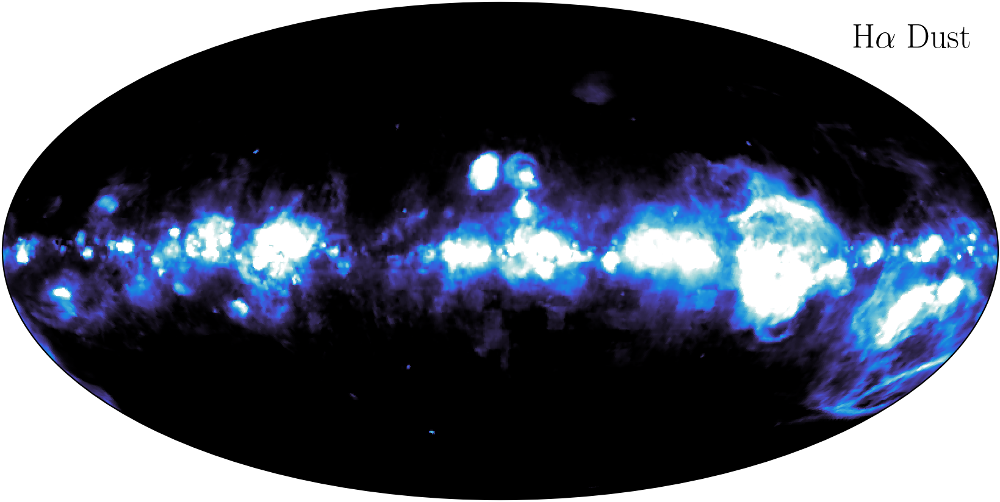

In [17]:
#WHAM
hp.projview(ha_init2,cmap=dust_cmap[3],min=-20,max=-1,
            unit=r'$\mu$K$_\mathrm{RJ,545 GHz}$',title=None,
            llabel=r'H$\alpha$ Dust',fontsize={"cbar_label":20,"cbar_tick_label":20},
            norm='symlog2')
plt.savefig('wham.pdf')

hp.projview(ha_init2,cmap=dust_cmap[3],min=-20,max=-1,cbar=None,title=None,
            llabel=r'H$\alpha$ Dust',fontsize={"cbar_label":20,"cbar_tick_label":20},
            norm='symlog2')
plt.savefig('wham_nocolourbar.pdf')

hp.projview(ha_init2,cmap=dust_cmap[3],min=-20,max=-1,cbar=None,title=None,
            rlabel=r'H$\alpha$ Dust',fontsize={"cbar_label":20,"cbar_tick_label":20},
            norm='symlog2')
plt.savefig('wham_nocolourbar_labelRight.pdf')


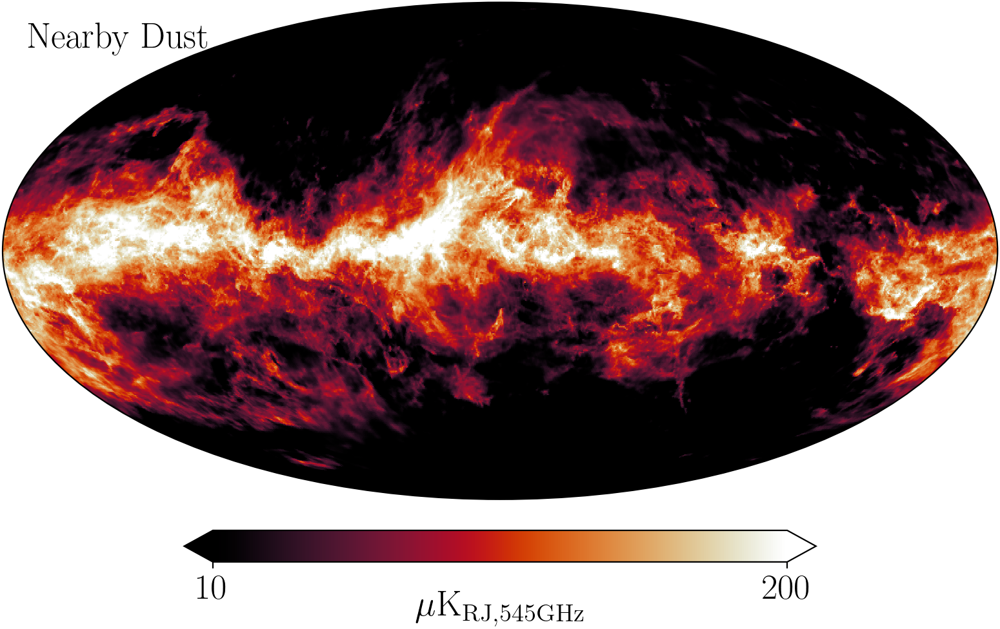

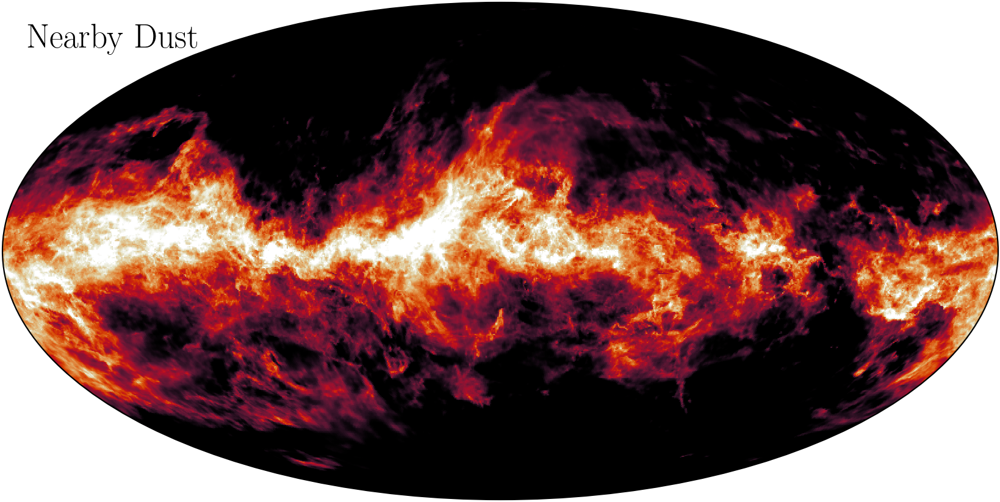

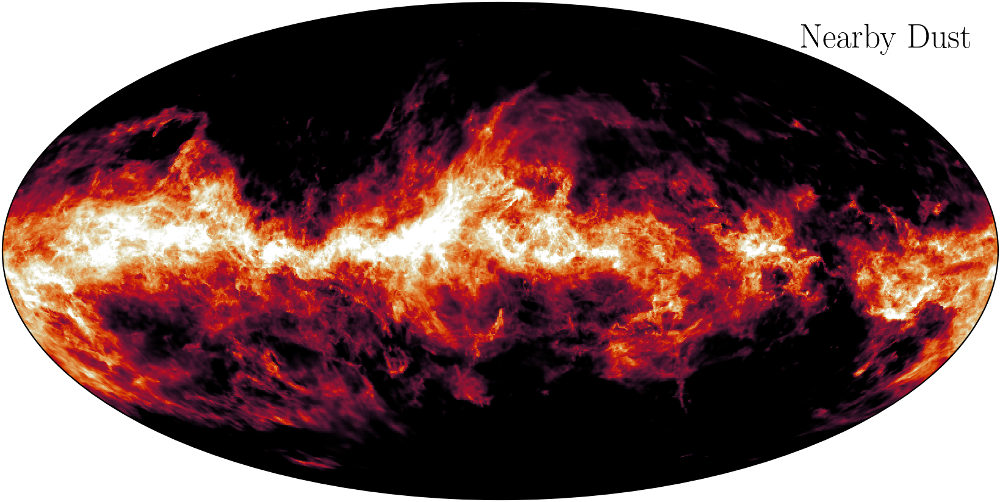

In [18]:
#edenhofer
hp.projview(pah_init3,cmap=dust_cmap[2],min=10,max=200,
            unit=r'$\mu$K$_\mathrm{RJ,545 GHz}$',title=None,llabel='Nearby Dust',
            fontsize={"cbar_label":20,"cbar_tick_label":20},
            norm='symlog2')
plt.savefig('edenhofer.pdf')

hp.projview(pah_init3,cmap=dust_cmap[2],min=10,max=200,cbar=None,title=None,
            llabel='Nearby Dust',fontsize={"cbar_label":20,"cbar_tick_label":20},
            norm='symlog2')
plt.savefig('edenhofer_nocolorbar.pdf')

hp.projview(pah_init3,cmap=dust_cmap[2],min=10,max=200,cbar=None,title=None,
            rlabel='Nearby Dust',fontsize={"cbar_label":20,"cbar_tick_label":20},
            norm='symlog2')
plt.savefig('edenhofer_nocolorbar_labelRight.pdf')

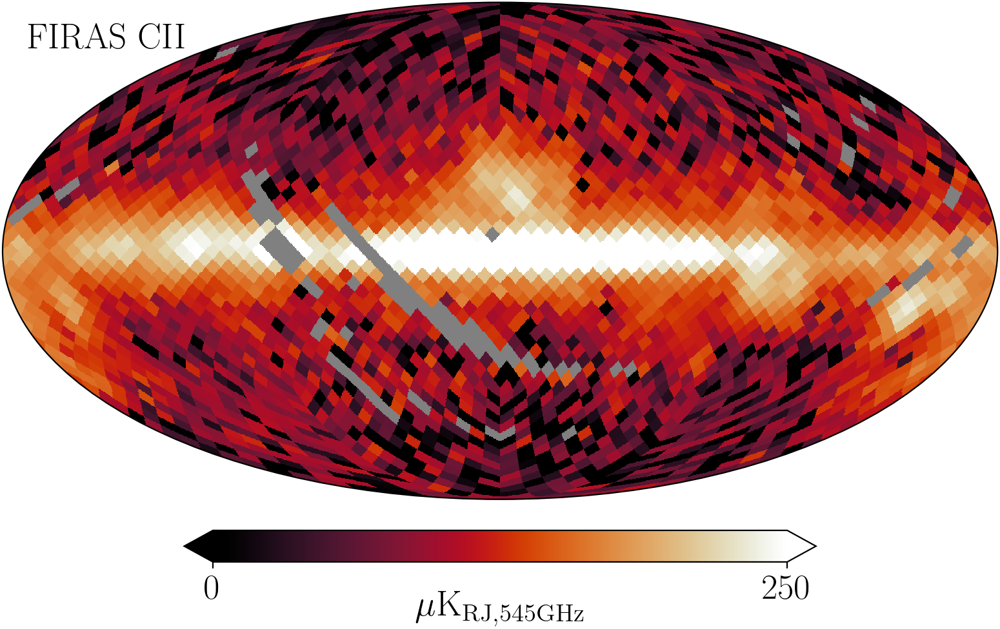

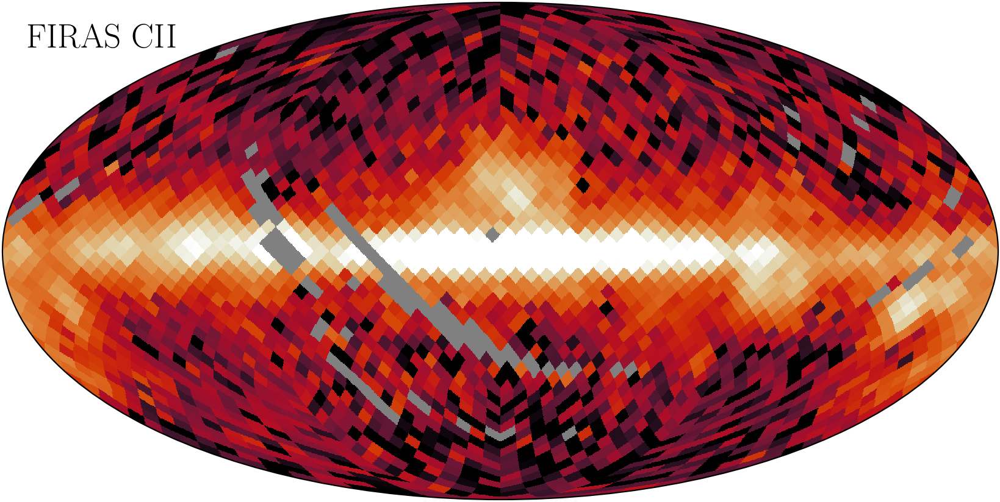

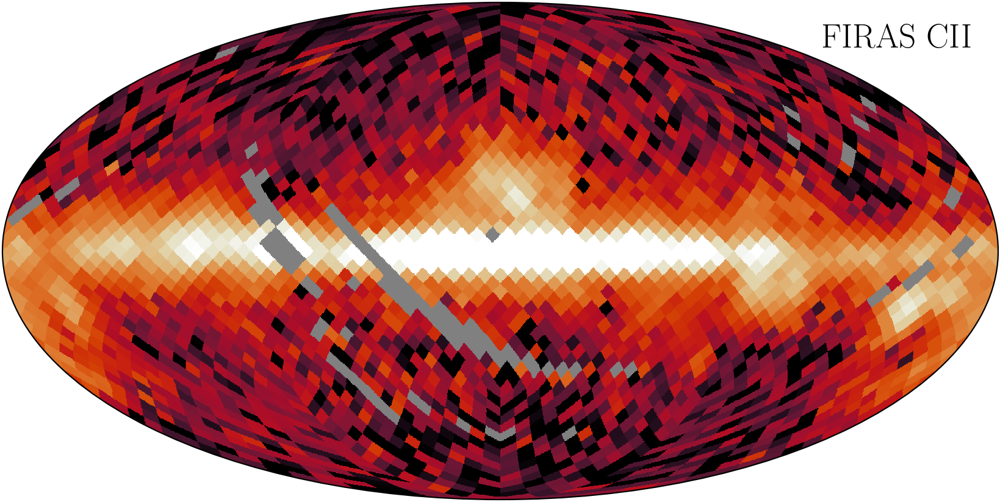

In [19]:
#FIRAS CII
hp.projview(firas_cii_masked,cmap=dust_cmap[1],max=250,min=0,
            unit=r'$\mu$K$_\mathrm{RJ,545 GHz}$',title=None,
            llabel='FIRAS CII',fontsize={"cbar_label":20,"cbar_tick_label":20},
            norm='symlog2')
plt.savefig('firas_CII.pdf')

hp.projview(firas_cii_masked,cmap=dust_cmap[1],max=250,min=0,cbar=None,title=None,
            llabel='FIRAS CII',fontsize={"cbar_label":20,"cbar_tick_label":20},
            norm='symlog2')
plt.savefig('firas_CII_nocolorbar.pdf')

hp.projview(firas_cii_masked,cmap=dust_cmap[1],max=250,min=0,cbar=None,title=None,
            rlabel='FIRAS CII',fontsize={"cbar_label":20,"cbar_tick_label":20},
            norm='symlog2')
plt.savefig('firas_CII_nocolorbar_labelRight.pdf')

/mn/stornext/u3/raelynsu/.conda/envs/plotEnv/lib/python3.13/site-packages/healpy/projaxes.py:923: RuntimeWarning: divide by zero encountered in log10
  return np.log10(0.5 * (x + np.sqrt(4.0 + x * x)))
/mn/stornext/u3/raelynsu/.conda/envs/plotEnv/lib/python3.13/site-packages/healpy/projaxes.py:923: RuntimeWarning: divide by zero encountered in log10
  return np.log10(0.5 * (x + np.sqrt(4.0 + x * x)))
/mn/stornext/u3/raelynsu/.conda/envs/plotEnv/lib/python3.13/site-packages/healpy/projaxes.py:923: RuntimeWarning: divide by zero encountered in log10
  return np.log10(0.5 * (x + np.sqrt(4.0 + x * x)))
/mn/stornext/u3/raelynsu/.conda/envs/plotEnv/lib/python3.13/site-packages/healpy/projaxes.py:923: RuntimeWarning: divide by zero encountered in log10
  return np.log10(0.5 * (x + np.sqrt(4.0 + x * x)))


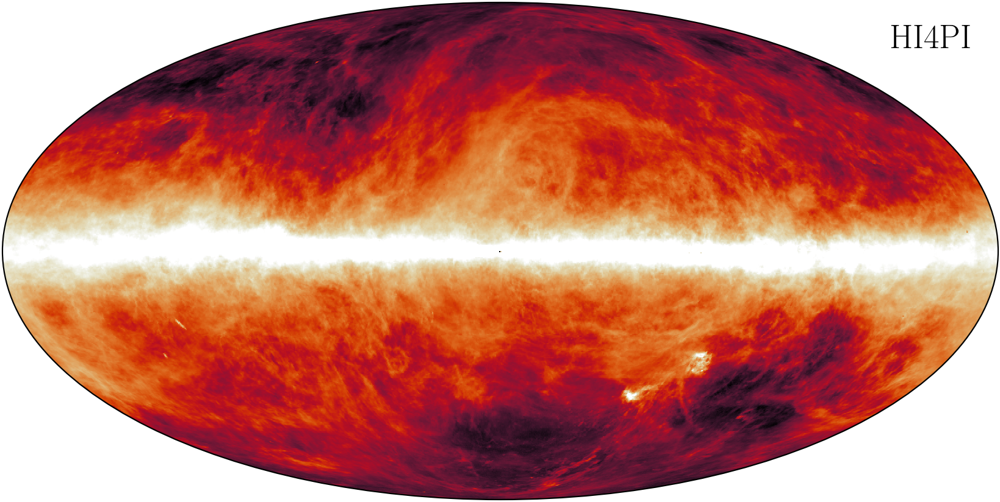

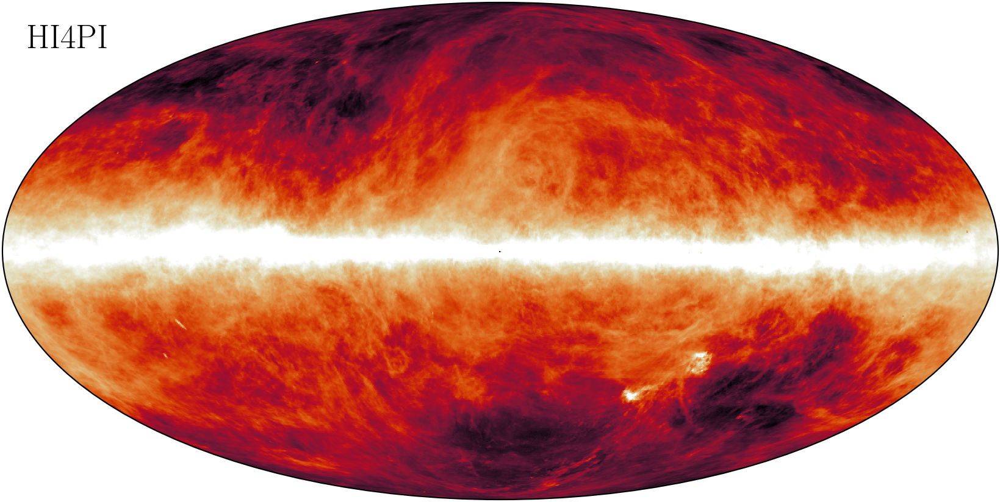

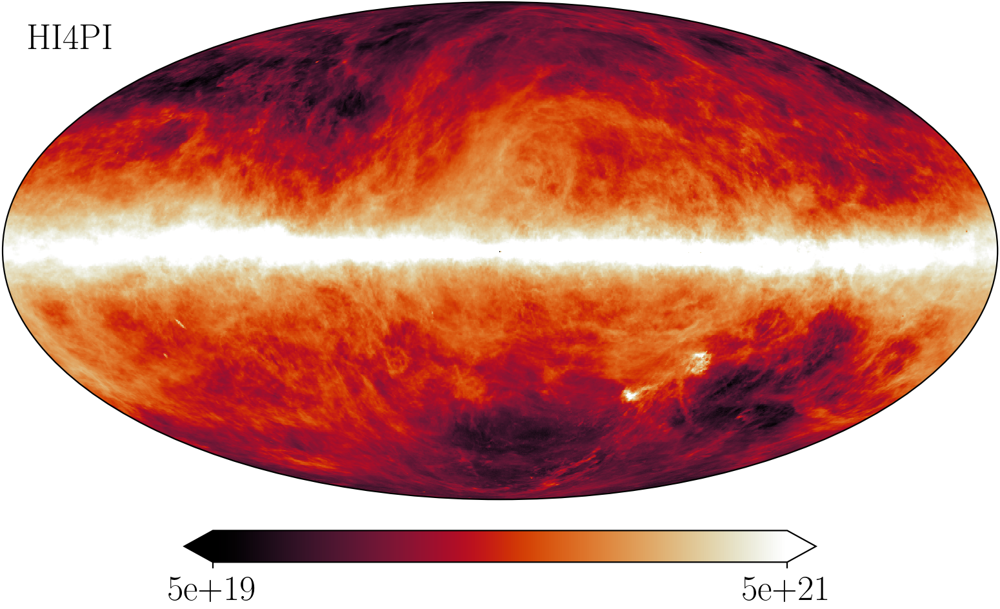

In [21]:
# #HI4PI map
hp.projview(Himap,cmap=dust_cmap[0],title=None,max=5e21,min=5e19,cbar=None,
            rlabel='HI4PI',fontsize={"cbar_label":20,"cbar_tick_label":20},
            norm='symlog2')
plt.savefig('HI4PI_nocolorbar_labelRight.pdf')

hp.projview(Himap,cmap=dust_cmap[0],title=None,max=5e21,min=5e19,cbar=None,
            llabel='HI4PI',fontsize={"cbar_label":20,"cbar_tick_label":20},
            norm='symlog2')
plt.savefig('HI4PI_nocolorbar.pdf')

hp.projview(Himap,cmap=dust_cmap[0],title=None,max=5e21,min=5e19,llabel='HI4PI',
            fontsize={"cbar_label":20,"cbar_tick_label":20},
            norm='symlog2')
plt.savefig('HI4PI.pdf')

In [33]:
dust_maps=[]
dust_maps_plotres=[]
for i in range(len(dust_names)):
    dust_maps.append(hp.read_map(dust_fil+str(fiducial)+dust_names[i]+nmend))
    dust_maps_plotres.append(downgrade(dust_maps[i],dust_sm[i],plot_sm,plot_res))

In [36]:
##comparison plot

# plt_kwargs_res={"fontsize":{"cbar_label":6,"cbar_tick_label":6},
#             "width":6.5}

# pltv=0
# muKrj2MJy=(1/(0.96e4))

# hp.projview(dust_maps_plotres[0],llabel=dust_titles[0],rlabel='DR2',
#             unit=r'$\mu\mathrm{K_{RJ}}$ at 545 GHz',min=1,max=3000,
#             cmap=dust_cmap[0],sub=(2,2,pltv+1),norm='symlog2',**plt_kwargs_res)
# pltv+=1
# hp.projview(Himap_plotres/1e20,llabel=r'$\mathrm{H\,I}$',rlabel='HI4PI',
#             unit=r'Column density ($\times 10^{20}$)',min=0.3,max=100,
#             cmap=dust_cmap[0],sub=(2,2,pltv+1),norm='symlog2',**plt_kwargs_res)
# pltv+=1
# hp.projview(dust_maps_plotres[1],llabel=dust_titles[1],rlabel='DR2',
#             unit=r'$\mu\mathrm{K_{RJ}}$ at 545 GHz',min=10,max=1000,
#             cmap=dust_cmap[1],sub=(2,2,pltv+1),norm='symlog2',**plt_kwargs_res)
# pltv+=1
# hp.projview(firas_cii_masked,llabel=r'$\mathrm{C\,II}$',rlabel='FIRAS',
#             unit='MJy/sr',min=1,max=1000,
#             cmap=dust_cmap[1],sub=(2,2,pltv+1),norm='symlog2',**plt_kwargs_res)


# plt.subplots_adjust(hspace=0.1, wspace=0.06)
# plt.savefig('dustComp.pdf', dpi=300, bbox_inches='tight')

# plt_kwargs={"fontsize":{"llabel":6*2,"rlabel":6*2},"width":6.5/2}
# hp.projview(dust_maps_plotres[0],llabel=dust_titles[0],rlabel='DR2',
#             unit=r'$\mu\mathrm{K_{RJ}}$ at 545 GHz',min=1,max=3000,
#             cmap=dust_cmap[0],norm='symlog2',**plt_kwargs)
# plt.savefig('dustComp_coldDust.pdf', dpi=300, bbox_inches='tight')

# plt.figure(figsize=(1.6,1.0))
# hp.projview(Himap_plotres/1e20,llabel=r'$\mathrm{H\,I}$',rlabel='HI4PI',
#             unit=r'Column density ($\times 10^{20}$)',min=0.3,max=100,
#             cmap=dust_cmap[0],norm='symlog2',**plt_kwargs)
# plt.figure(figsize=(1.6,1.0))
# plt.savefig('dustComp_Himap.pdf', dpi=300, bbox_inches='tight')

# hp.projview(dust_maps_plotres[1],llabel=dust_titles[1],rlabel='DR2',
#             unit=r'$\mu\mathrm{K_{RJ}}$ at 545 GHz',min=10,max=1000,
#             cmap=dust_cmap[1],norm='symlog2',**plt_kwargs)
# plt.savefig('dustComp_hotDust.pdf', dpi=300, bbox_inches='tight')


# hp.projview(firas_cii_masked,llabel=r'$\mathrm{C\,II}$',rlabel='FIRAS',
#             unit='MJy/sr',min=1,max=1000,
#             cmap=dust_cmap[1],norm='symlog2',**plt_kwargs)
# plt.savefig('dustComp_firasCII.pdf', dpi=300, bbox_inches='tight')




In [37]:
cold_dust_2048=downgrade(dust_maps[0],5,10,2048)
hot_dust_2048=downgrade(dust_maps[1],5,10,2048)

total_dust_2048=cold_dust_2048+hot_dust_2048+dust_maps[2]+dust_maps[3]

In [38]:
total_dust_pos_2048=np.abs(cold_dust_2048)+np.abs(hot_dust_2048)+np.abs(dust_maps[2])+np.abs(dust_maps[3])

In [39]:
dust_fraction=[cold_dust_2048/total_dust_2048,hot_dust_2048/total_dust_2048,
               dust_maps[2]/total_dust_2048,dust_maps[3]/total_dust_2048]

dust_fraction_plotres_down=[
    downgrade(dust_fraction[0],10,plot_sm,plot_res),
    downgrade(dust_fraction[1],10,plot_sm,plot_res),
    downgrade(dust_fraction[2],10,plot_sm,plot_res),
    downgrade(dust_fraction[3],10,plot_sm,plot_res)]

In [40]:
dust_fraction_pos=[np.abs(cold_dust_2048)/total_dust_pos_2048,np.abs(hot_dust_2048)/total_dust_pos_2048,
               np.abs(dust_maps[2])/total_dust_pos_2048,np.abs(dust_maps[3])/total_dust_pos_2048]

dust_fraction_plotres_down_pos=[
    downgrade(dust_fraction_pos[0],10,plot_sm,plot_res),
    downgrade(dust_fraction_pos[1],10,plot_sm,plot_res),
    downgrade(dust_fraction_pos[2],10,plot_sm,plot_res),
    downgrade(dust_fraction_pos[3],10,plot_sm,plot_res)]

In [98]:
# hp.projview(dust_fraction_plotres_down[0],llabel=dust_titles[0],
#             unit=r'Fraction $\mu\mathrm{K_{RJ}}$ at 545 GHz',max=1/10,min=-1/10,
#             cmap='cmr.iceburn',**plt_kwargs_res)

# plt.show()

# hp.projview(dust_fraction_plotres_down[2],llabel=dust_titles[2],
#             unit=r'Fraction $\mu\mathrm{K_{RJ}}$ at 545 GHz',max=1.01,min=0.7,
#             cmap='cmr.iceburn',**plt_kwargs_res)

# plt.show()

/mn/stornext/u3/raelynsu/.conda/envs/plotEnv/lib/python3.13/site-packages/healpy/newvisufunc.py:407: UserWarning: 
 *** Overriding default plot properies: {'cbar_shrink': 0.6, 'cbar_pad': 0.05, 'cbar_label_pad': -8, 'cbar_tick_direction': 'out', 'vertical_tick_rotation': 90, 'figure_width': 7.5, 'figure_size_ratio': 0.63} ***
  warnings.warn(
/mn/stornext/u3/raelynsu/.conda/envs/plotEnv/lib/python3.13/site-packages/healpy/newvisufunc.py:411: UserWarning: 
 *** New plot properies: {'cbar_shrink': 0.6, 'cbar_pad': 0.025, 'cbar_label_pad': -8, 'cbar_tick_direction': 'out', 'vertical_tick_rotation': 90, 'figure_width': 7.5, 'figure_size_ratio': 0.63} ***
  warnings.warn("\n *** New plot properies: " + str(plot_properties) + " ***")
/mn/stornext/u3/raelynsu/.conda/envs/plotEnv/lib/python3.13/site-packages/healpy/newvisufunc.py:407: UserWarning: 
 *** Overriding default plot properies: {'cbar_shrink': 0.6, 'cbar_pad': 0.05, 'cbar_label_pad': -8, 'cbar_tick_direction': 'out', 'vertical_tick_r

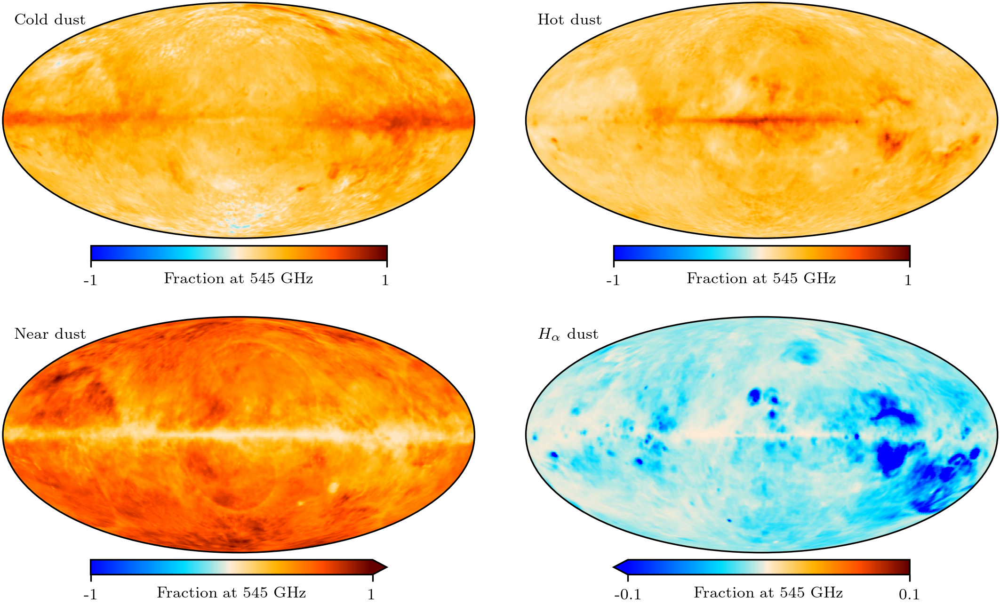

In [47]:
##fraction plot

plt_kwargs_res={"override_plot_properties":{"cbar_pad":0.025,'cbar_label_pad':-8},
            "fontsize":{"cbar_label":8,"cbar_tick_label":8},
            "width":7.5}

pltv=0

hp.projview(dust_fraction_plotres_down[0],llabel=dust_titles[0],
            unit=r'Fraction at 545 GHz',max=1,min=-1,
            cmap=plcmap,sub=(2,2,pltv+1),**plt_kwargs_res)
pltv+=1
hp.projview(dust_fraction_plotres_down[1],llabel=dust_titles[1],
            unit=r'Fraction at 545 GHz',max=1,min=-1,
            cmap=plcmap,sub=(2,2,pltv+1),**plt_kwargs_res)
pltv+=1
hp.projview(dust_fraction_plotres_down[2],llabel=dust_titles[2],
            unit=r'Fraction at 545 GHz',max=1,min=-1,
            cmap=plcmap,sub=(2,2,pltv+1),**plt_kwargs_res)
pltv+=1
hp.projview(dust_fraction_plotres_down[3],llabel=dust_titles[3],
            unit=r'Fraction at 545 GHz',max=1/10,min=-1/10,
            cmap=plcmap,sub=(2,2,pltv+1),**plt_kwargs_res)
pltv+=1

plt.subplots_adjust(hspace=0.1, wspace=0.06)
plt.savefig('dustFrac_plcmap.pdf', dpi=300, bbox_inches='tight')

/mn/stornext/u3/raelynsu/.conda/envs/plotEnv/lib/python3.13/site-packages/healpy/newvisufunc.py:407: UserWarning: 
 *** Overriding default plot properies: {'cbar_shrink': 0.6, 'cbar_pad': 0.05, 'cbar_label_pad': -8, 'cbar_tick_direction': 'out', 'vertical_tick_rotation': 90, 'figure_width': 7.5, 'figure_size_ratio': 0.63} ***
  warnings.warn(
/mn/stornext/u3/raelynsu/.conda/envs/plotEnv/lib/python3.13/site-packages/healpy/newvisufunc.py:411: UserWarning: 
 *** New plot properies: {'cbar_shrink': 0.6, 'cbar_pad': 0.025, 'cbar_label_pad': 2, 'cbar_tick_direction': 'out', 'vertical_tick_rotation': 90, 'figure_width': 7.5, 'figure_size_ratio': 0.63} ***
  warnings.warn("\n *** New plot properies: " + str(plot_properties) + " ***")
/mn/stornext/u3/raelynsu/.conda/envs/plotEnv/lib/python3.13/site-packages/healpy/newvisufunc.py:407: UserWarning: 
 *** Overriding default plot properies: {'cbar_shrink': 0.6, 'cbar_pad': 0.05, 'cbar_label_pad': -8, 'cbar_tick_direction': 'out', 'vertical_tick_ro

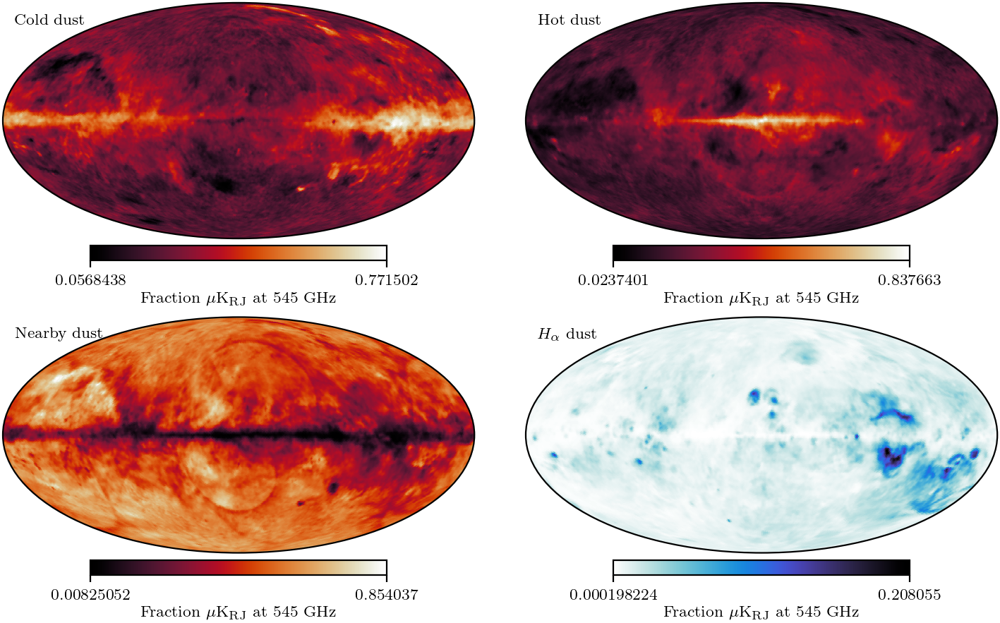

In [ ]:
##fraction plot

plt_kwargs_res={"override_plot_properties":{"cbar_pad":0.025,'cbar_label_pad': 2},
            "fontsize":{"cbar_label":8,"cbar_tick_label":8},
            "width":7.5}

pltv=0

hp.projview(dust_fraction_plotres_down_pos[0],llabel=dust_titles[0],
            unit=r'Fraction $\mu\mathrm{K_{RJ}}$ at 545 GHz',
            cmap=dust_cmap[0],sub=(2,2,pltv+1),**plt_kwargs_res)
pltv+=1
hp.projview(dust_fraction_plotres_down_pos[1],llabel=dust_titles[1],
            unit=r'Fraction $\mu\mathrm{K_{RJ}}$ at 545 GHz',
            cmap=dust_cmap[1],sub=(2,2,pltv+1),**plt_kwargs_res)
pltv+=1
hp.projview(dust_fraction_plotres_down_pos[2],llabel=dust_titles[2],
            unit=r'Fraction $\mu\mathrm{K_{RJ}}$ at 545 GHz',
            cmap=dust_cmap[2],sub=(2,2,pltv+1),**plt_kwargs_res)
pltv+=1
hp.projview(dust_fraction_plotres_down_pos[3],llabel=dust_titles[3],
            unit=r'Fraction $\mu\mathrm{K_{RJ}}$ at 545 GHz',
            cmap=dust_cmap[3],sub=(2,2,pltv+1),**plt_kwargs_res)
pltv+=1

plt.subplots_adjust(hspace=0.1, wspace=0.06)
plt.savefig('dustFrac_pos.pdf', dpi=300, bbox_inches='tight')

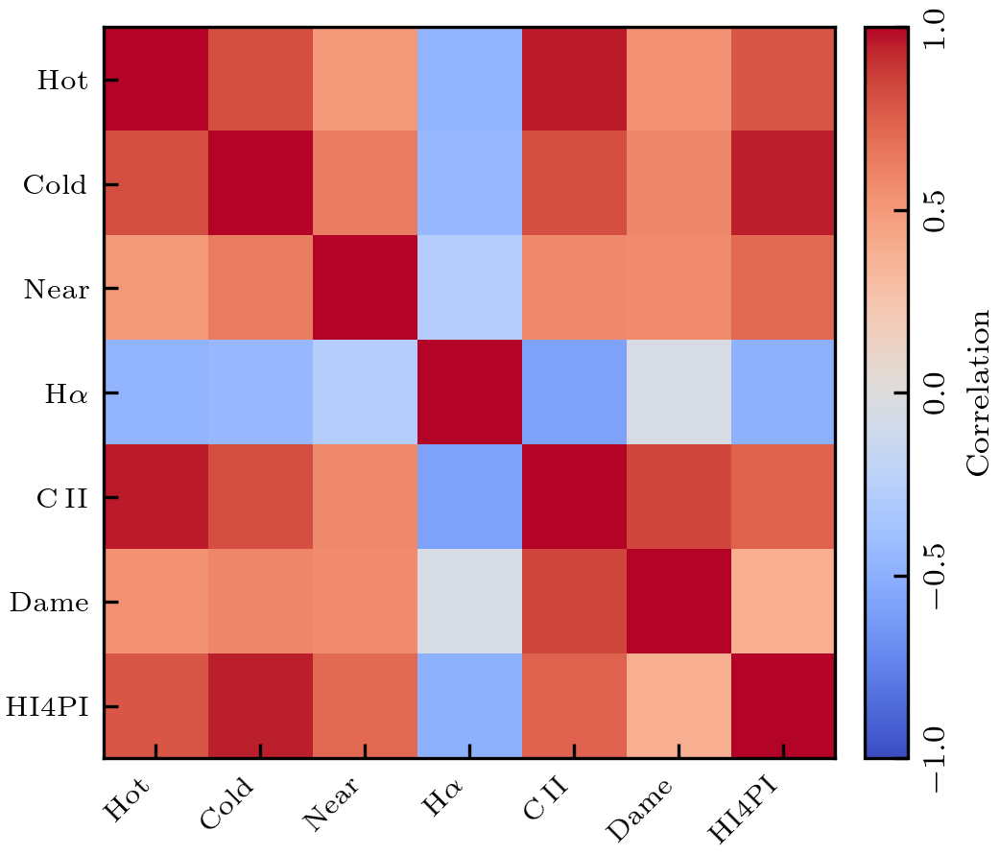

In [61]:

corrGrid = np.load('corrGrid.npy')

# A&A one-column width ~ 3.5 in, square figure
fig, ax = plt.subplots(figsize=(3.5, 3.5))

im = ax.imshow(corrGrid, cmap='coolwarm', vmin=-1, vmax=1)

labs = ['Hot', 'Cold', 'Near', r'H$\alpha$', r'$\mathrm{C\,II}$', 'Dame', 'HI4PI']

# # Colorbar sized for one-column layout
# cbar = ax.figure.colorbar(im, ax=ax,fraction=0.0451)
# cbar.ax.set_ylabel('Correlation', fontsize=8)
# cbar.ax.tick_params(labelsize=7)

cax = ax.inset_axes([1.04, 0.0, 0.06, 1.0])  # [x0, y0, width, height] in axes fraction
cbar = fig.colorbar(im, cax=cax, orientation='vertical')
cbar.set_label('Correlation', fontsize=8)
cbar.ax.tick_params(labelsize=8)
for t in cbar.ax.get_yticklabels():
    t.set_rotation(90)
    # t.set_horizontalalignment('center')
    t.set_verticalalignment('center')

ticks = [-1.0, -0.5, 0.0, 0.5, 1.0]
labels = [r'$-1.0$', r'$-0.5$', r'$0.0$',r'$0.5$', r'$1.0$']

cbar.set_ticks(ticks)
cbar.set_ticklabels(labels)




# Ticks and labels
ax.set_xticks(range(len(labs)))
ax.set_yticks(range(len(labs)))

ax.set_xticklabels(labs, rotation=45, ha="right", fontsize=8)
ax.set_yticklabels(labs, fontsize=8)

ax.tick_params(axis='both', which='both', labelsize=7)

# Tight layout for journal formatting
fig.tight_layout(pad=0.3)

plt.savefig('correlation_plot_fs.pdf', dpi=300, bbox_inches='tight')
plt.show()


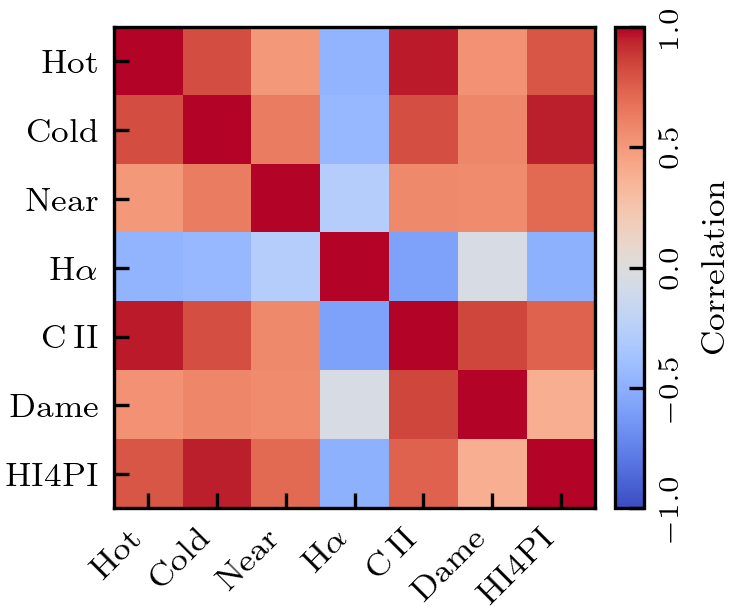

In [62]:

corrGrid = np.load('corrGrid.npy')

# A&A one-column width ~ 3.5 in, square figure
fig, ax = plt.subplots(figsize=(2.5, 2.5))

im = ax.imshow(corrGrid, cmap='coolwarm', vmin=-1, vmax=1)

labs = ['Hot', 'Cold', 'Near', r'H$\alpha$', r'$\mathrm{C\,II}$', 'Dame', 'HI4PI']

# # Colorbar sized for one-column layout
# cbar = ax.figure.colorbar(im, ax=ax,fraction=0.0451)
# cbar.ax.set_ylabel('Correlation', fontsize=8)
# cbar.ax.tick_params(labelsize=7)

cax = ax.inset_axes([1.04, 0.0, 0.06, 1.0])  # [x0, y0, width, height] in axes fraction
cbar = fig.colorbar(im, cax=cax, orientation='vertical')
cbar.set_label('Correlation', fontsize=8)
cbar.ax.tick_params(labelsize=7)
for t in cbar.ax.get_yticklabels():
    t.set_rotation(90)
    # t.set_horizontalalignment('center')
    t.set_verticalalignment('center')

ticks = [-1.0, -0.5, 0.0, 0.5, 1.0]
labels = [r'$-1.0$', r'$-0.5$', r'$0.0$',r'$0.5$', r'$1.0$']

cbar.set_ticks(ticks)
cbar.set_ticklabels(labels)




# Ticks and labels
ax.set_xticks(range(len(labs)))
ax.set_yticks(range(len(labs)))

ax.set_xticklabels(labs, rotation=45, ha="right", fontsize=8)
ax.set_yticklabels(labs, fontsize=8)

ax.tick_params(axis='both', which='both', labelsize=8)

# Tight layout for journal formatting
fig.tight_layout(pad=0.3)

plt.savefig('correlation_plot.pdf', dpi=300, bbox_inches='tight')
plt.show()


In [145]:
hfi_maps=[]
residual_maps=[]
freq_lst=[]
cmb_maps=[]
for i in range(len(freqs)):
    for j in range(len(band_arr[i])):
        res_map=hp.read_map(dust_fil+str(fiducial)+nmr+str(freqs[i])+band_arr[i][j]+fil)
        residual_maps.append(res_map)
        
        # hfi_maps.append(hp.read_map(data_folder+nmd+str(freqs[i])+band_arr[i][j]+dfil[i]))
        # freq_lst.append(freqs[i])
        # cmb_maps.append(hp.read_map(dust_fil+str(fiducial)+'/cmb_'+str(freqs[i])+band_arr[i][j]+fil)) #CMB in uk_cmb so constant across all frequencies?
        

# np.save('residual_maps_smoothed_'+str(smooth)+'arcmin.npy',np.asarray(residual_maps_sm))

#without smoothing takes about 6 minutes to run 

In [ ]:
# hot_dust_maps=[]
# cold_dust_maps=[]
# near_dust_maps=[]
# wham_dust_maps=[]
# for i in range(len(freqs)):
#     for j in range(len(band_arr[i])):
#         hot_dust_maps.append(hp.read_map(dust_fil+str(fiducial)+'/dust_cii_'+str(freqs[i])+band_arr[i][j]+fil))
#         cold_dust_maps.append(hp.read_map(dust_fil+str(fiducial)+'/dust_'+str(freqs[i])+band_arr[i][j]+fil))
#         near_dust_maps.append(hp.read_map(dust_fil+str(fiducial)+'/dust_Ha_'+str(freqs[i])+band_arr[i][j]+fil))
#         wham_dust_maps.append(hp.read_map(dust_fil+str(fiducial)+'/hotPAH_'+str(freqs[i])+band_arr[i][j]+fil))

In [ ]:
# for i in range(len(residual_maps)):
#     residual_maps_sm.append(hp.smoothing(residual_maps[i],np.deg2rad(smooth/60)))
# with open("smooth_residuals_120", "wb") as fp:   #Pickling
#     pickle.dump(residual_maps_sm, fp)

# with open("smooth_residuals_120", "rb") as fp:   # Unpickling
#     residual_maps_sm = pickle.load(fp)

In [ ]:
##efficiency:
dust_eff_avg=np.loadtxt('dust_efficiency_average.txt')
dust_eff=np.loadtxt('dust_efficiency.txt')
eff=np.loadtxt('efficiency.txt')

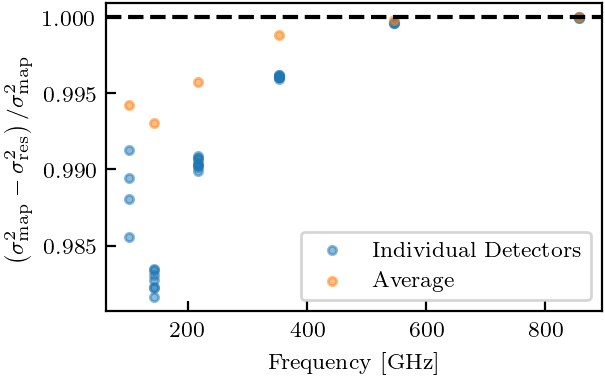

In [ ]:
fig, ax = plt.subplots()

freq_shift=np.asarray((-1,-0.5,0.5,1,
                      -1.5,-1,-0.5,0,0.5,1,1.5,
                      -2,-1.5,-1,-0.5,0.5,1,1.5,2,
                      -2,-1.5,-1,-0.5,0.5,1,1.5,2,
                      -0.5,0,0.5,
                      -1,-0.5,0.5,1))

ax.set_xlabel('Frequency [GHz]')
ax.set_ylabel(r'$\left(\sigma^2_\mathrm{map}-\sigma^2_\mathrm{res}\right)/\sigma^2_\mathrm{map}$')

ax.scatter(dust_eff[:,0],dust_eff[:,1],marker='.',alpha=0.5,label='Individual Detectors')
# ax.scatter(eff[:,0],eff[:,1],marker='.',alpha=0.5,label='All components')
ax.scatter(dust_eff_avg[:,0],dust_eff_avg[:,1],marker='.',alpha=0.5,label='Average')

plt.axhline(1,ls='--',color='black')
# plt.axvline(100,color='grey',alpha=0.2)
# plt.axvline(143,color='grey',alpha=0.2)
# plt.axvline(217,color='grey',alpha=0.2)
# plt.axvline(353,color='grey',alpha=0.2)
# plt.axvline(545,color='grey',alpha=0.2)
# plt.axvline(857,color='grey',alpha=0.2)

plt.legend()
plt.savefig('All_efficiency.pdf')


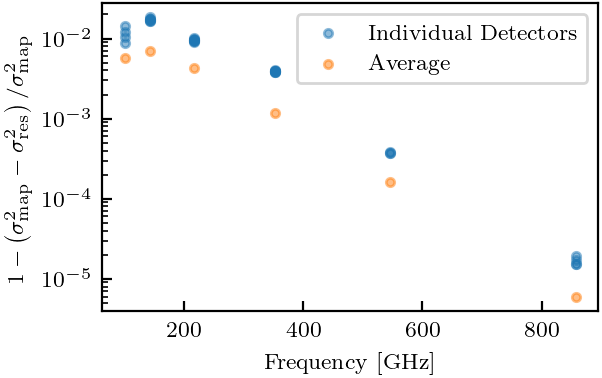

In [132]:
fig, ax = plt.subplots()
ax.set_xlabel('Frequency [GHz]')
ax.set_ylabel(r'$1-\left(\sigma^2_\mathrm{map}-\sigma^2_\mathrm{res}\right)/\sigma^2_\mathrm{map}$')

ax.scatter(dust_eff[:,0],1-dust_eff[:,1],marker='.',alpha=0.5,label='Individual Detectors')
# ax.scatter(eff[:,0],eff[:,1],marker='.',alpha=0.5,label='All components')
ax.scatter(dust_eff_avg[:,0],1-dust_eff_avg[:,1],marker='.',alpha=0.5,label='Average')
ax.set_yscale('log')
plt.axhline(0,ls='--',color='black')
# plt.axvline(100,color='grey',alpha=0.2)
# plt.axvline(143,color='grey',alpha=0.2)
# plt.axvline(217,color='grey',alpha=0.2)
# plt.axvline(353,color='grey',alpha=0.2)
# plt.axvline(545,color='grey',alpha=0.2)
# plt.axvline(857,color='grey',alpha=0.2)

plt.legend()
# plt.show()
plt.savefig('All_efficiency_log.pdf')

In [ ]:
fig, ax = plt.subplots()

freq_shift=np.asarray((-1,-0.5,0.5,1,
                      -1.5,-1,-0.5,0,0.5,1,1.5,
                      -2,-1.5,-1,-0.5,0.5,1,1.5,2,
                      -2,-1.5,-1,-0.5,0.5,1,1.5,2,
                      -0.5,0,0.5,
                      -1,-0.5,0.5,1))

ax.set_xlabel('Frequency [GHz]')
ax.set_ylabel(r'$\left(\sigma^2_\mathrm{map}-\sigma^2_\mathrm{res}\right)/\sigma^2_\mathrm{map}$')

ax.scatter(dust_eff[:,0],dust_eff[:,1],marker='.',alpha=0.5)

plt.axhline(1,ls='--',color='black')
plt.axvline(100,color='grey',alpha=0.2)
plt.axvline(143,color='grey',alpha=0.2)
plt.axvline(217,color='grey',alpha=0.2)
plt.axvline(353,color='grey',alpha=0.2)
plt.axvline(545,color='grey',alpha=0.2)
plt.axvline(857,color='grey',alpha=0.2)


plt.savefig('dust_efficiency.pdf')

In [ ]:
fig, ax = plt.subplots()


ax.set_xlabel('Frequency [GHz]')
ax.set_ylabel(r'$\left(\sigma^2_\mathrm{map}-\sigma^2_\mathrm{res}\right)/\sigma^2_\mathrm{map}$')

ax.scatter(dust_eff_avg[:,0],dust_eff_avg[:,1],marker='.',alpha=0.5)

plt.axhline(1,ls='--',color='black')
# plt.axvline(100,color='grey',alpha=0.2)
# plt.axvline(143,color='grey',alpha=0.2)
# plt.axvline(217,color='grey',alpha=0.2)
# plt.axvline(353,color='grey',alpha=0.2)
# plt.axvline(545,color='grey',alpha=0.2)
# plt.axvline(857,color='grey',alpha=0.2)


plt.savefig('dust_efficiency_average.pdf')

In [ ]:
fig, ax = plt.subplots()

freq_shift=np.asarray((-1,-0.5,0.5,1,
                      -1.5,-1,-0.5,0,0.5,1,1.5,
                      -2,-1.5,-1,-0.5,0.5,1,1.5,2,
                      -2,-1.5,-1,-0.5,0.5,1,1.5,2,
                      -0.5,0,0.5,
                      -1,-0.5,0.5,1))

ax.set_xlabel('Frequency [GHz]')
ax.set_ylabel(r'$\left(\sigma^2_\mathrm{map}-\sigma^2_\mathrm{res}\right)/\sigma^2_\mathrm{map}$')

ax.scatter(eff[:,0],eff[:,1],marker='.',alpha=0.5)

plt.axhline(1,ls='--',color='black')
plt.axvline(100,color='grey',alpha=0.2)
plt.axvline(143,color='grey',alpha=0.2)
plt.axvline(217,color='grey',alpha=0.2)
plt.axvline(353,color='grey',alpha=0.2)
plt.axvline(545,color='grey',alpha=0.2)
plt.axvline(857,color='grey',alpha=0.2)


plt.savefig('efficiency.pdf')

In [ ]:
# ##calculate the efficiency
# eff=[]
# eff_map=[]
# for i in range(len(hfi_maps)):
#     temp1,temp2=get_eff(hfi_maps[i],residual_maps[i],cmb_maps[i])
#     eff.append(temp1)
#     eff_map.append(temp2)
    
# np.savetxt('efficiency.txt',np.asarray((freq_lst, eff)).T)
#takes about 5 minutes to run?

In [ ]:
# dust_eff=[]
# dust_eff_map=[]
# # hot_dust_maps=[]
# # cold_dust_maps=[]
# # near_dust_maps=[]
# # wham_dust_maps=[]
# for i in range(len(hfi_maps)):
#     dmap=hot_dust_maps[i]+hot_dust_maps[i]+near_dust_maps[i]+wham_dust_maps[i]
#     temp1,temp2=get_eff_dust(dmap,residual_maps[i])
#     dust_eff.append(temp1)
#     dust_eff_map.append(temp2)

# np.savetxt('dust_efficiency.txt',np.asarray((freq_lst, dust_eff)).T)

In [ ]:
# dust_eff_avg=[]
# dust_eff_map_avg=[]
# # hot_dust_maps=[]
# # cold_dust_maps=[]
# # near_dust_maps=[]
# # wham_dust_maps=[]
# p=0
# for i in range(len(freqs)):
#     for j in range(len(band_arr[i])):
#         if j==0:
#             print(i,j,p,freqs[i],band_arr[i][j])
#             dmap=hot_dust_maps[p]+hot_dust_maps[p]+near_dust_maps[p]+wham_dust_maps[p]
#             residual_sum=residual_maps[p]
#         else:
#             print(i,j,p,freqs[i],band_arr[i][j])
#             dmap+=hot_dust_maps[p]+hot_dust_maps[p]+near_dust_maps[p]+wham_dust_maps[p]
#             residual_sum+=residual_maps[p]
#         p+=1
#     print('next')
#     temp1,temp2=get_eff_dust(dmap,residual_sum)
#     dust_eff_avg.append(temp1)
#     dust_eff_map_avg.append(temp2)

# freq_lst_sm=[100,143,217,353,545,857]
# np.savetxt('dust_efficiency_average.txt',np.asarray((freq_lst_sm, dust_eff_avg)).T)

In [ ]:
# for i in range(len(freq_lst_sm)):
#     print(sum(dust_eff_map_avg[i]<0)/len(dust_eff_map_avg[i]))

# 0.016657650470733643
# 0.020344237486521404
# 0.012665058175722757
# 0.003529613216718038
# 0.0004902184009552002
# 1.7841657002766926e-05

In [ ]:
# for i in range(len(hfi_maps)):
#     print(sum(dust_eff_map[i]<0)/len(eff_map[i]))

# 0.023736000061035156
# 0.03241966168085734
# 0.0391345222791036
# 0.028841018676757812
# 0.046590824921925865
# 0.0520100990931193
# 0.05021939675013224
# 0.0479248563448588
# 0.04882317781448364
# 0.047048608462015785
# 0.05017280578613281
# 0.028288036584854126
# 0.02796409527460734
# 0.0286076416571935
# 0.029345462719599407
# 0.026837781071662903
# 0.02704000969727834
# 0.0282222976287206
# 0.02647473414738973
# 0.011708185076713562
# 0.011377642552057901
# 0.011731445789337158
# 0.01174605389436086
# 0.0119858980178833
# 0.011260375380516052
# 0.011669347683588663
# 0.01149966816107432
# 0.0011198918024698894
# 0.0011376986900965373
# 0.0011113882064819336
# 4.983445008595785e-05
# 4.470348358154297e-05
# 4.72863515218099e-05
# 5.8372815450032554e-05

In [ ]:
# for i in range(len(hfi_maps)):
#     print(sum(eff_map[i]<0)/len(eff_map[i]))

#100
# 0.03683352470397949
# 0.04654735326766968
# 0.051586429278055825
# 0.042540132999420166
#143
# 0.04869518677393595
# 0.047251224517822266
# 0.047881642977396645
# 0.0485685666402181
# 0.04833050568898519
# 0.048635780811309814
# 0.047934512297312416
#217
# 0.03006063401699066
# 0.029799972971280415
# 0.03029501934846242
# 0.030600229899088543
# 0.029214868942896526
# 0.029170289635658264
# 0.030097713073094685
# 0.028845017155011494
#353
# 0.0027604748805363974
# 0.0023076782623926797
# 0.007580697536468506
# 0.006073792775472005
# 0.006419256329536438
# 0.008846074342727661
# 0.006041372815767924 
# 0.006033658981323242
#545
# 0.0033328731854756675
# 0.0034226030111312866
# 0.0033518075942993164
#857
# 0.00018005569775899252
# 0.00016689300537109375
# 0.0001704047123591105
# 0.00020362933476765951


In [135]:
# res_avg=[]
# dust_avg=[]
# count=0
# for i in range(len(freqs)):
#     residual_maps_sum=np.zeros_like(residual_maps[count])
#     dust_avg_sum=np.zeros_like(cold_dust_maps[count])
#     for j in range(len(band_arr[i])):
#         residual_maps_sum+=residual_maps[count]
#         dust_avg_sum+=(cold_dust_maps[count]+hot_dust_maps[count]+near_dust_maps[count]+wham_dust_maps[count])
#         count+=1
#     res_avg.append(residual_maps_sum/len(band_arr[i]))
#     dust_avg.append(dust_avg_sum/len(band_arr[i]))
        
# with open("dust_average", "wb") as fp:   #Pickling
#     pickle.dump(dust_avg, fp)

# with open("res_average", "wb") as fp:   #Pickling
#     pickle.dump(res_avg, fp)

with open("dust_average", "rb") as fp:   # Unpickling
    dust_avg = pickle.load(fp)

with open("res_average", "rb") as fp:   # Unpickling
    res_avg = pickle.load(fp)


In [22]:
# dust_maps_hot_grid_h=[]
# dust_maps_hot_grid_c=[]
# dust_maps_hot_grid_h_plotres=[]
# dust_maps_hot_grid_c_plotres=[]
# for i in range(len(secondary_hotgrid)):
#     dust_maps_hot_grid_h.append(hp.read_map(dust_fil+str(secondary_hotgrid[i])+dust_names[1]+nmend))
#     dust_maps_hot_grid_h_plotres.append(downgrade(dust_maps_hot_grid_h[i],dust_sm[1],plot_sm,plot_res))
#     dust_maps_hot_grid_c.append(hp.read_map(dust_fil+str(secondary_hotgrid[i])+dust_names[0]+nmend))
#     dust_maps_hot_grid_c_plotres.append(downgrade(dust_maps_hot_grid_c[i],dust_sm[0],plot_sm,plot_res))

In [21]:

# with open("dust_maps_hot_grid_c_plotres", "wb") as fp:   #Pickling
#     pickle.dump(dust_maps_hot_grid_c_plotres, fp)

# with open("dust_maps_hot_grid_h_plotres", "wb") as fp:   #Pickling
#     pickle.dump(dust_maps_hot_grid_h_plotres, fp)

# with open("res_average_sm120", "rb") as fp:   # Unpickling
#     res_avg_sm = pickle.load(fp)

In [20]:
# dust_maps_cold_grid_h=[]
# dust_maps_cold_grid_c=[]
# dust_maps_cold_grid_h_plotres=[]
# dust_maps_cold_grid_c_plotres=[]
# for i in range(len(secondary_coldgrid)):
#     dust_maps_cold_grid_h.append(hp.read_map(dust_fil+str(secondary_coldgrid[i])+dust_names[1]+nmend))
#     dust_maps_cold_grid_h_plotres.append(downgrade(dust_maps_cold_grid_h[i],dust_sm[1],plot_sm,plot_res))
#     dust_maps_cold_grid_c.append(hp.read_map(dust_fil+str(secondary_coldgrid[i])+dust_names[0]+nmend))
#     dust_maps_cold_grid_c_plotres.append(downgrade(dust_maps_cold_grid_c[i],dust_sm[0],plot_sm,plot_res))

In [19]:
# with open("dust_maps_cold_grid_c_plotres", "wb") as fp:   #Pickling
#     pickle.dump(dust_maps_cold_grid_c_plotres, fp)

# with open("dust_maps_cold_grid_h_plotres", "wb") as fp:   #Pickling
#     pickle.dump(dust_maps_cold_grid_h_plotres, fp)

In [18]:
# dust_maps_near_grid_h=[]
# dust_maps_near_grid_c=[]
# dust_maps_near_grid_h_plotres=[]
# dust_maps_near_grid_c_plotres=[]
# for i in range(len(secondary_neargrid)):
#     dust_maps_near_grid_h.append(hp.read_map(dust_fil+str(secondary_neargrid[i])+dust_names[1]+nmend))
#     dust_maps_near_grid_h_plotres.append(downgrade(dust_maps_near_grid_h[i],dust_sm[1],plot_sm,plot_res))
#     dust_maps_near_grid_c.append(hp.read_map(dust_fil+str(secondary_neargrid[i])+dust_names[0]+nmend))
#     dust_maps_near_grid_c_plotres.append(downgrade(dust_maps_near_grid_c[i],dust_sm[0],plot_sm,plot_res))

In [23]:
with open("dust_maps_hot_grid_h_plotres", "rb") as fp:   # Unpickling
    dust_maps_hot_grid_h_plotres = pickle.load(fp)

with open("num_hotgrid", "rb") as fp:   # Unpickling
    num_hotgrid = pickle.load(fp)

# pltv=0
# print('plotting data')
# print(num_hotgrid)
# for i in range(len(secondary_hotgrid)):
#     labl=r'$T_\mathrm{h}=$'+str(params_new['T_hot'][params_new['num']==secondary_hotgrid[i]][0])
#     labr=r'$\beta_\mathrm{h}=$'+str(params_new['beta_hot'][params_new['num']==secondary_hotgrid[i]][0])
#     if pltv==22:
#         hp.projview(dust_maps_hot_grid_h_plotres[i]/dust_maps_hot_grid_h_plotres[12],#llabel=labl,rlabel=labr,
#                 max=1,min=-1,cmap=plcmap,sub=(5,5,pltv+1),unit=dust_units[1],
#                 title=labl+', '+labr,norm='symlog2',**plt_kwargs_res)
#     else:
#         hp.projview(dust_maps_hot_grid_h_plotres[i]/dust_maps_hot_grid_h_plotres[12],#llabel=labl,rlabel=labr,
#                 max=1,min=-1,cmap=plcmap,sub=(5,5,pltv+1),unit=dust_units[1],
#                 title=labl+', '+labr,cbar=None,norm='symlog2',**plt_kwargs_res)
#     pltv+=1

# plt.subplots_adjust(hspace=0.1, wspace=0.06)
# plt.savefig('HotDust_hot_Grid_ratio.pdf')

In [142]:
dust_avg_plotres=[]
for i in range(len(dust_avg)):
    dust_avg_plotres.append(downgrade(dust_avg[i]+res_avg[i],5,plot_sm,plot_res))

with open("dust_average_plotres", "wb") as fp:   #Pickling
    pickle.dump(dust_avg_plotres, fp)

# with open("dust_average_plotres", "rb") as fp:   # Unpickling
#     dust_avg_sm = pickle.load(fp)


res_avg_plotres=[]
for i in range(len(dust_avg)):
    res_avg_plotres.append(downgrade(res_avg[i],5,plot_sm,plot_res))

with open("res_average_plotres", "wb") as fp:   #Pickling
    pickle.dump(res_avg_plotres, fp)

# with open("res_average_sm120", "rb") as fp:   # Unpickling
#     res_avg_sm = pickle.load(fp)

/mn/stornext/u3/raelynsu/.conda/envs/plotEnv/lib/python3.13/site-packages/healpy/newvisufunc.py:407: UserWarning: 
 *** Overriding default plot properies: {'cbar_shrink': 0.6, 'cbar_pad': 0.05, 'cbar_label_pad': -8, 'cbar_tick_direction': 'out', 'vertical_tick_rotation': 90, 'figure_width': 6.5, 'figure_size_ratio': 0.63} ***
  warnings.warn(
/mn/stornext/u3/raelynsu/.conda/envs/plotEnv/lib/python3.13/site-packages/healpy/newvisufunc.py:411: UserWarning: 
 *** New plot properies: {'cbar_shrink': 0.6, 'cbar_pad': 0.025, 'cbar_label_pad': -6, 'cbar_tick_direction': 'out', 'vertical_tick_rotation': 90, 'figure_width': 6.5, 'figure_size_ratio': 0.63} ***
  warnings.warn("\n *** New plot properies: " + str(plot_properties) + " ***")
/mn/stornext/u3/raelynsu/.conda/envs/plotEnv/lib/python3.13/site-packages/healpy/newvisufunc.py:407: UserWarning: 
 *** Overriding default plot properies: {'cbar_shrink': 0.6, 'cbar_pad': 0.05, 'cbar_label_pad': -8, 'cbar_tick_direction': 'out', 'vertical_tick_r

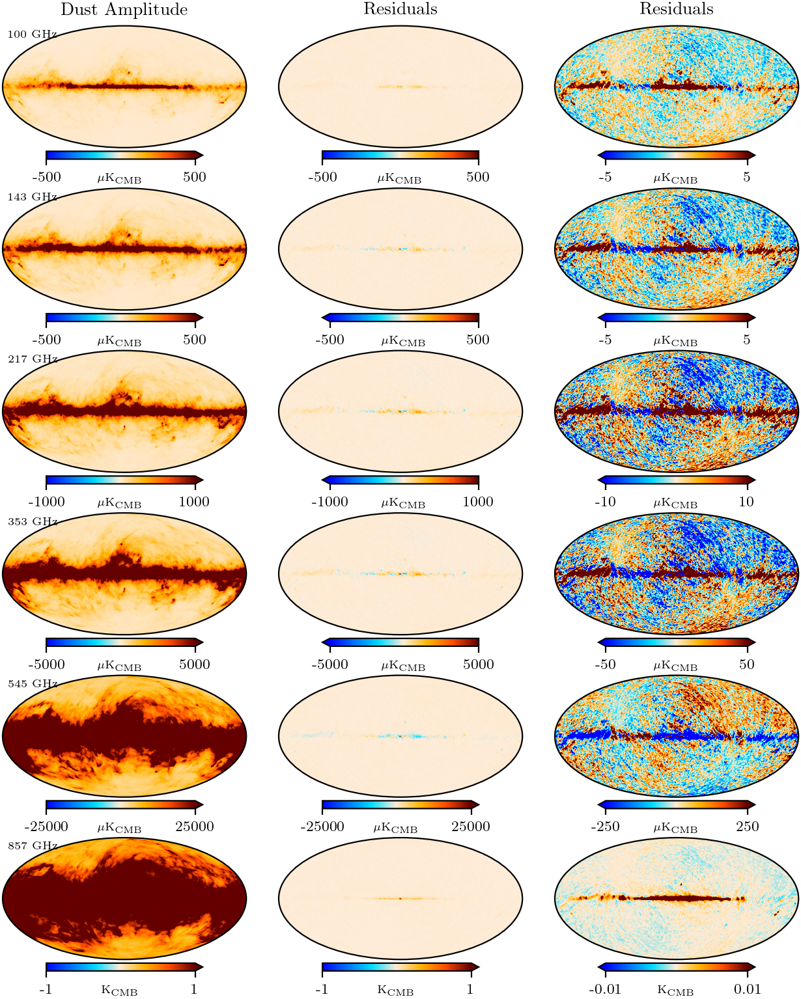

In [143]:
plt_kwargs_res={"override_plot_properties":{"cbar_pad":0.025,'cbar_label_pad': -6},
            "width":6.5,"fontsize":{"cbar_label":6,"cbar_tick_label":8,"title":10}}

unitv=[r'$\mu \mathrm{K}_\mathrm{CMB}$',r'$\mu \mathrm{K}_\mathrm{CMB}$',r'$\mu \mathrm{K}_\mathrm{CMB}$',
       r'$\mu \mathrm{K}_\mathrm{CMB}$',r'$\mu \mathrm{K}_\mathrm{CMB}$',r'$\mathrm{K}_\mathrm{CMB}$']
scale=[1,1,1,1,1,1e-6]
freqs_sm=[100,143]
pltv=0
freq_mm=[5,5,10,50,250,1e-2]


for i in range(len(freqs)):
    if i==0:
        titlev=['Dust Amplitude','Residuals','Residuals']
    else:
        titlev=[None,None,None]
    hp.projview(dust_avg_plotres[i]*scale[i],llabel=str(freqs[i])+' GHz',
                max=freq_mm[i]*100,min=-1*freq_mm[i]*100,cmap=res_cmap,sub=(6,3,pltv+1),unit=unitv[i],
                title=titlev[0],**plt_kwargs_res)
    pltv+=1
    hp.projview(res_avg_plotres[i]*scale[i],
                max=freq_mm[i]*100,min=-1*freq_mm[i]*100,cmap=res_cmap,sub=(6,3,pltv+1),unit=unitv[i],
                title=titlev[1],**plt_kwargs_res)
    pltv+=1
    hp.projview(res_avg_plotres[i]*scale[i],
                max=freq_mm[i],min=-1*freq_mm[i],cmap=res_cmap,sub=(6,3,pltv+1),unit=unitv[i],
                title=titlev[2],**plt_kwargs_res)
    pltv+=1

plt.subplots_adjust(hspace=0.1, wspace=0.06)
plt.savefig('AvgDust_Grid_plotres.pdf')

In [ ]:
# dust_avg_sm=[]
# for i in range(len(freqs)):
#     dust_avg_sm.append(hp.smoothing(dust_avg[i]+res_avg[i],fwhm=np.deg2rad(120/60)))

# with open("dust_average_sm120", "wb") as fp:   #Pickling
#     pickle.dump(dust_avg_sm, fp)

# with open("dust_average_sm120", "rb") as fp:   # Unpickling
#     dust_avg_sm = pickle.load(fp)


# res_avg_sm=[]
# for i in range(len(freqs)):
#     res_avg_sm.append(hp.smoothing(res_avg[i],fwhm=np.deg2rad(120/60)))

# with open("res_average_sm120", "wb") as fp:   #Pickling
#     pickle.dump(res_avg_sm, fp)

# with open("res_average_sm120", "rb") as fp:   # Unpickling
#     res_avg_sm = pickle.load(fp)

In [10]:
# plt_kwargs_res={"override_plot_properties":{"cbar_pad":0.025,'cbar_label_pad': -6},
#             "width":6.5,"fontsize":{"cbar_label":6,"cbar_tick_label":8,"title":10}}

# unitv=[r'$\mu \mathrm{K}_\mathrm{CMB}$',r'$\mu \mathrm{K}_\mathrm{CMB}$',r'$\mu \mathrm{K}_\mathrm{CMB}$',
#        r'$\mu \mathrm{K}_\mathrm{CMB}$',r'$\mu \mathrm{K}_\mathrm{CMB}$',r'$\mathrm{K}_\mathrm{CMB}$']
# scale=[1,1,1,1,1,1e-6]
# freqs_sm=[100,143]
# pltv=0
# freq_mm=[5,5,10,50,250,1e-2]


# for i in range(len(freqs)):
#     if i==0:
#         titlev=['Dust Amplitude','Residuals','Residuals']
#     else:
#         titlev=[None,None,None]
#     hp.projview(dust_avg_sm[i]*scale[i],llabel=str(freqs[i])+' GHz',
#                 max=freq_mm[i]*100,min=-1*freq_mm[i]*100,cmap=res_cmap,sub=(6,3,pltv+1),unit=unitv[i],
#                 title=titlev[0],**plt_kwargs_res)
#     pltv+=1
#     hp.projview(res_avg_sm[i]*scale[i],
#                 max=freq_mm[i]*100,min=-1*freq_mm[i]*100,cmap=res_cmap,sub=(6,3,pltv+1),unit=unitv[i],
#                 title=titlev[1],**plt_kwargs_res)
#     pltv+=1
#     hp.projview(res_avg_sm[i]*scale[i],
#                 max=freq_mm[i],min=-1*freq_mm[i],cmap=res_cmap,sub=(6,3,pltv+1),unit=unitv[i],
#                 title=titlev[2],**plt_kwargs_res)
#     pltv+=1

# plt.subplots_adjust(hspace=0.1, wspace=0.06)
# plt.savefig('AvgDust_Grid_smcbar.pdf')

In [ ]:
##masks
#gain mask
gain_mask=hp.read_map(data_folder+'mask_857_gain_rs1.fits')
firas_samp_mask=hp.read_map('mask_30deg_n16.fits')
samp_HFI_mask=hp.read_map(data_folder+'mask_dust_gal_v6.fits')

chisq_mask=hp.read_map('chi_mask.fits')

In [ ]:
# hp.projview(gain_mask,cmap='binary_r',cbar=None)
# plt.savefig('gain857_mask.pdf')

# hp.projview(firas_samp_mask,cmap='binary_r',cbar=None)
# plt.savefig('firas_samp_mask.pdf')

# hp.projview(samp_HFI_mask,cmap='binary_r',cbar=None)
# plt.savefig('samp_HFI_mask.pdf')

# hp.projview(chisq_mask,cmap='binary_r',cbar=None)
# plt.savefig('chisq_mask.pdf')


In [ ]:
# plt_kwargs_res={"override_plot_properties":{"cbar_pad":0.025,'cbar_label_pad': -8},
#             "fontsize":{"cbar_label":6,"cbar_tick_label":6},"unit":r'$\mu \mathrm{K}_\mathrm{CMB}',
#             "width":6.5}

# pltv=0
# freq_mm=[5,5,10,50,250,10000]
# for i in range(len(freqs)):
#     for j in range(len(band_arr[i])):
#         hp.projview(residual_maps_sm[pltv],rlabel=str(freqs[i])+band_arr[i][j],
#                     max=freq_mm[i],min=-1*freq_mm[i],cmap=res_cmap,sub=(9,4,pltv+1))
#         pltv+=1

# plt.subplots_adjust(hspace=0.1, wspace=0.06)
# plt.savefig('hotdust_Grid.pdf')

In [ ]:
# with open("smooth_residuals_120", "rb") as fp:   # Unpickling
#     residual_maps_sm = pickle.load(fp)

In [ ]:
# residual_maps_sm_plotres=[]
# for i in range(len(residual_maps_sm)):
#     residual_maps_sm_plotres.append(hp.ud_grade(residual_maps_sm[i],plot_res))

# with open("residual_maps_sm_plotres", "wb") as fp:   #Pickling
#     pickle.dump(residual_maps_sm_plotres, fp)

# with open("residual_maps_sm_plotres", "rb") as fp:   # Unpickling
#     residual_maps_sm_plotres = pickle.load(fp)

In [13]:
# residual_maps_sm_plotres=[]
# for i in range(len(residual_maps)):
#     residual_maps_sm_plotres.append(downgrade(residual_maps[i],5,plot_sm,plot_res))

# with open("residual_maps_sm_plotres", "wb") as fp:   #Pickling
#     pickle.dump(residual_maps_sm_plotres, fp)

with open("residual_maps_sm_plotres", "rb") as fp:   # Unpickling
    residual_maps_sm_plotres = pickle.load(fp)

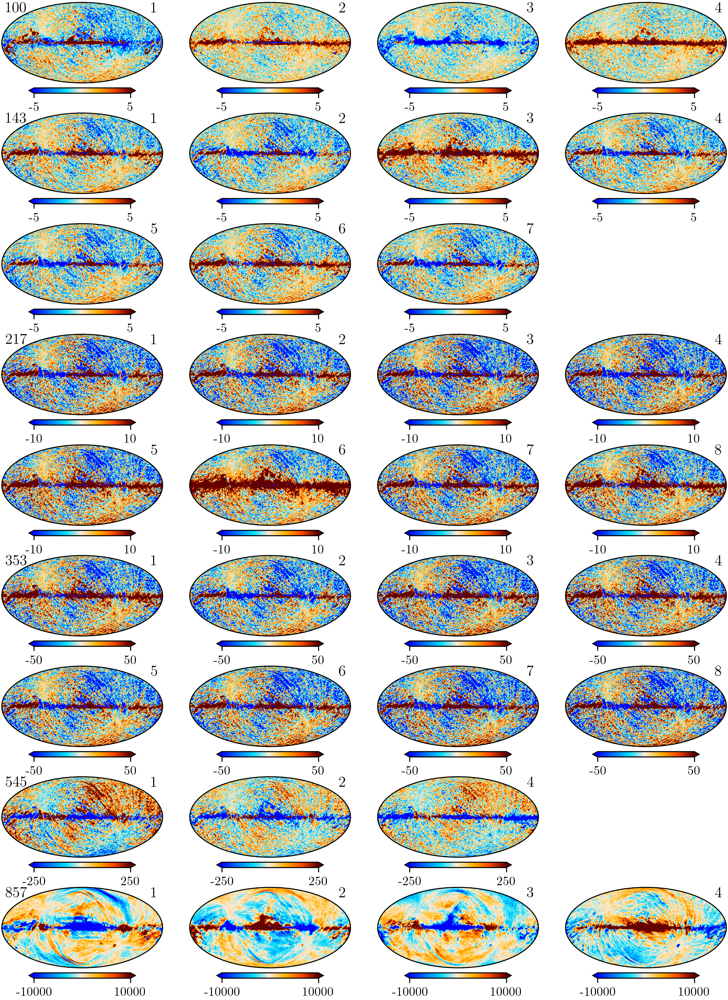

In [ ]:
plt_kwargs_res={"override_plot_properties":{"cbar_pad":0.025,'cbar_label_pad': -8},
            "fontsize":{"cbar_label":5,"cbar_tick_label":5},"unit":r'$\mu \mathrm{K}_\mathrm{CMB}',
            "width":6.5}

pltv=0
count=0
freq_mm=[5,5,10,50,250,10000]
for i in range(len(freqs)):
    for j in range(len(band_arr[i])):
        if (freqs[i]==217 and band_arr[i][j]=='-1'):
            pltv+=1
        if (freqs[i]==857 and band_arr[i][j]=='-1'):
            pltv+=1
        if band_arr[i][j]=='-1':
            llab=str(freqs[i])
        else:
            llab=None
        hp.projview(residual_maps_sm_plotres[count],llabel=llab,rlabel=band_arr[i][j],
                    max=freq_mm[i],min=-1*freq_mm[i],cmap=res_cmap,sub=(9,4,pltv+1))
        pltv+=1
        count+=1

plt.subplots_adjust(hspace=0.1, wspace=0.06)
plt.savefig('residuals_plotres.pdf')

In [ ]:

# plt_kwargs_res={"override_plot_properties":{"cbar_pad":0.025,'cbar_label_pad': -8},
#             "fontsize":{"cbar_label":6,"cbar_tick_label":6},"unit":r'$\mu \mathrm{K}_\mathrm{CMB}',
#             "width":6.5}

# pltv=0
# freq_mm=[5,5,10,50,250,10000]
# for i in range(len(freqs)):
#     # for j in range(len(band_arr[i])):
#     hp.projview(residual_maps_sm[pltv],rlabel=str(freqs[i])+band_arr[i][j],
#                     max=freq_mm[i],min=-1*freq_mm[i],cmap=res_cmap,sub=(6,2,pltv+1))
#     pltv+=1
#     hp.projview(residual_maps_sm[pltv],rlabel=str(freqs[i])+band_arr[i][j],
#                     max=freq_mm[i],min=-1*freq_mm[i],cmap=res_cmap,sub=(6,2,pltv+1))

# plt.subplots_adjust(hspace=0.1, wspace=0.06)

In [ ]:
gain=[]
dat=Table.read(dust_fil+str(fiducial)+'/instpar'+'_c0001_k'+str(samp).zfill(6)+'.dat',format='ascii')

gain.append([dat['Gain'][dat['Band']=='545-1'][0]])
gain.append([dat['Gain'][dat['Band']=='545-2'][0]])
gain.append([dat['Gain'][dat['Band']=='545-4'][0]])
gain.append([dat['Gain'][dat['Band']=='857-1'][0]])
gain.append([dat['Gain'][dat['Band']=='857-2'][0]])
gain.append([dat['Gain'][dat['Band']=='857-3'][0]])
gain.append([dat['Gain'][dat['Band']=='857-4'][0]])

columns=['Gain scale']
rows=['545-1','545-2','545-4','857-1','857-2','857-3','857-4']

gtab=generate_planck_table_latex(gain,rows,columns,first_col='Band',include_uncertainty=False,label='tab:gains',digits=5)
gtab2=generate_planck_table_latex2(gain,rows,columns,first_col='Band',include_uncertainty=False,label='tab:gains',digits=5)

print(gtab)

print()

print(gtab2)

\begin{table}[tbp!]
\begingroup
\newdimen\tblskip \tblskip=5pt
\nointerlineskip
\vskip -3mm
\footnotesize
\setbox\tablebox=\vbox{
   \newdimen\digitwidth
   \setbox0=\hbox{\rm 0}
   \digitwidth=\wd0
   \catcode`*=\active
   \def*{\kern\digitwidth}
   \newdimen\signwidth
   \setbox0=\hbox{+}
   \signwidth=\wd0
   \catcode`!=\active
   \def!{\kern\signwidth}
\halign{\tabskip 0pt \hbox to 1in{#\leaderfil}\tabskip 0pt&\hfil#\hfil\tabskip 0pt\cr
\noalign{\doubleline\vskip 1pt}
\omit\hfil Band \hfil& !Gain scale\cr
\noalign{\vskip 4pt\hrule\vskip 6pt}
\noalign{\vskip 3pt}
545-1& $ 0.99145 $\cr
\noalign{\vskip 3pt}
545-2& $ 1.00487 $\cr
\noalign{\vskip 3pt}
545-4& $ 1.00830 $\cr
\noalign{\vskip 3pt}
857-1& $ 0.99362 $\cr
\noalign{\vskip 3pt}
857-2& $ 1.10242 $\cr
\noalign{\vskip 3pt}
857-3& $ 1.02393 $\cr
\noalign{\vskip 3pt}
857-4& $ 1.13470 $\cr
\noalign{\vskip 3pt}
\noalign{\vskip 3pt\hrule\vskip 4pt}}}
\endPlancktable
\endgroup
\caption{}
\label{tab:gains}
\end{table}

\begin{table}[tbp!]

In [63]:
fg_titles=[r'$A_\mathrm{CO01}$',r'$A_\mathrm{CO21}$',r'$A_\mathrm{CO32}$',r'$A_\mathrm{ff}$',r'$A_\mathrm{CMB}$']
fg_titles_nl=[r'$A_\mathrm{CO01}$',r'$A_\mathrm{CO21}$',r'$A_\mathrm{CO32}$',r'$A_\mathrm{ff}$',r'$A_\mathrm{CMB}$']
fg_names=['co100','co217','co353','ff','cmb']
fg_cmap=["cmr.arctic","cmr.arctic","cmr.arctic",'cmr.freeze',plcmap]
fg_maxc=[1,1,1,1000,600]
fg_minc=[-1,-1,-1,-100,-600]
fg_units=['K-km/s','K-km/s','K-km/s',r'$\mu \mathrm{K}_\mathrm{RJ}$',r'$\mu \mathrm{K}_\mathrm{CMB}$']
fg_sm=[9.5,5.0,5.0,15,5]
fg_resol=[2048,2048,2048,1024,2048]

In [64]:
# fg_maps=[]
# fg_maps_plotres=[]
# i=0
# fg_maps.append(hp.read_map(dust_fil+str(fiducial)+'/'+fg_names[i]+fil))
# fg_maps_plotres.append(downgrade(fg_maps[i],fg_sm[i],plot_sm,plot_res))
# i=1
# fg_maps.append(hp.read_map(dust_fil+str(fiducial)+'/'+fg_names[i]+fil))
# fg_maps_plotres.append(downgrade(fg_maps[i],fg_sm[i],plot_sm,plot_res))
# i=2
# fg_maps.append(hp.read_map(dust_fil+str(fiducial)+'/'+fg_names[i]+fil))
# fg_maps_plotres.append(downgrade(fg_maps[i],fg_sm[i],plot_sm,plot_res))
# i=3
# fg_maps.append(hp.read_map(dust_fil+str(fiducial)+'/'+fg_names[i]+fil))
# fg_maps_plotres.append(downgrade(fg_maps[i],fg_sm[i],plot_sm,plot_res))
# i=4
# fg_maps.append(hp.remove_dipole(hp.read_map(dust_fil+str(fiducial)+'/'+fg_names[i]+fil)))
# fg_maps_plotres.append(downgrade(fg_maps[i],fg_sm[i],plot_sm,plot_res))

# with open("fg_maps_plotres", "wb") as fp:   #Pickling
#     pickle.dump(fg_maps_plotres, fp)


with open("fg_maps_plotres", "rb") as fp:   # Unpickling
    fg_maps_plotres = pickle.load(fp)

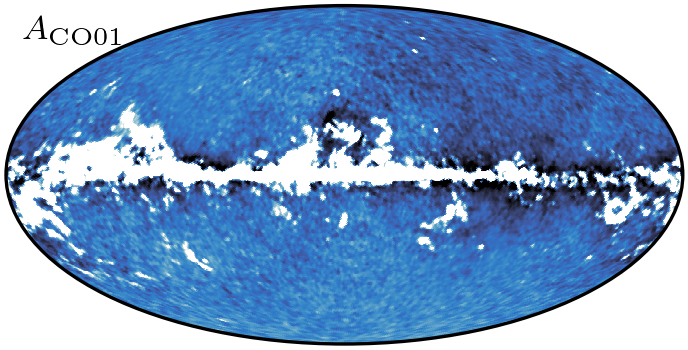

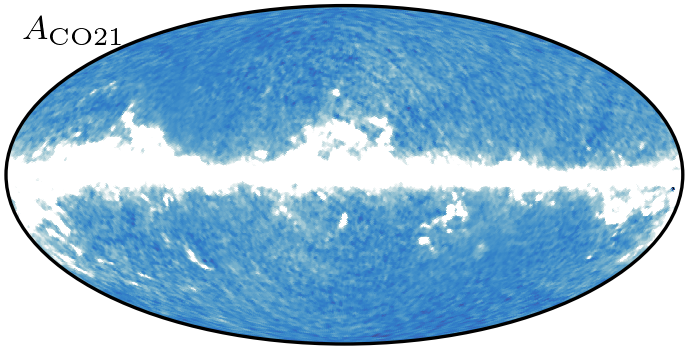

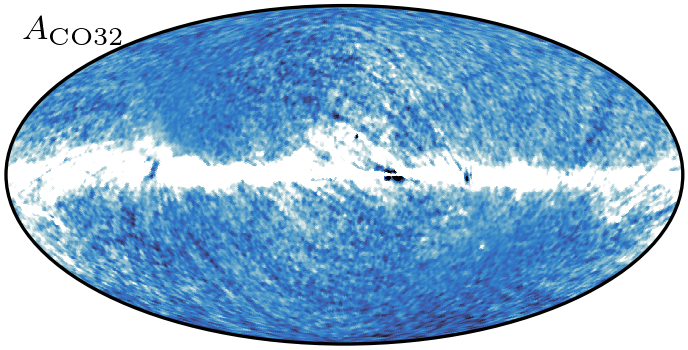

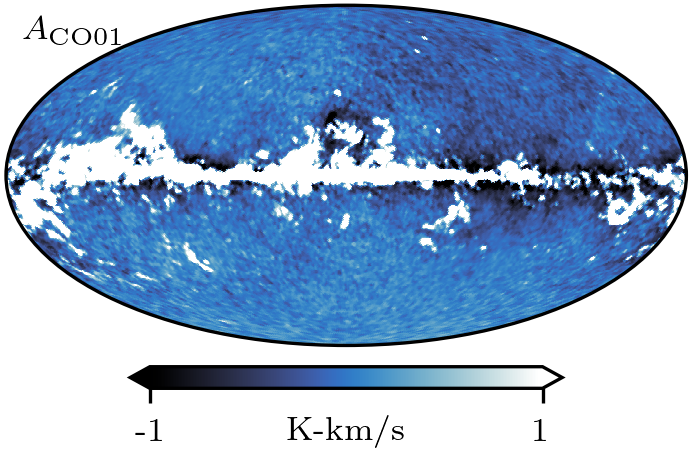

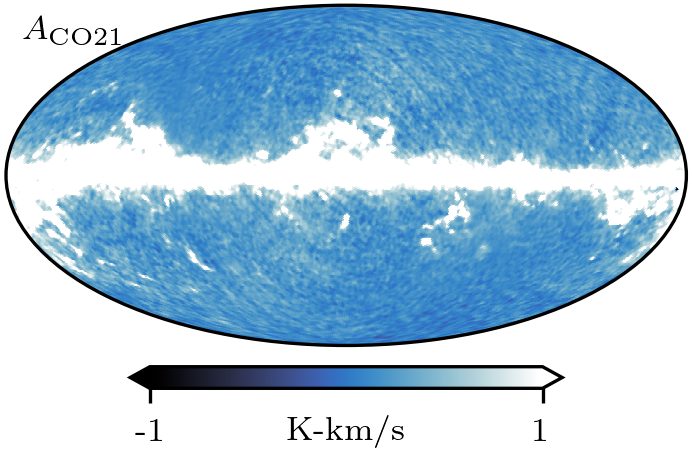

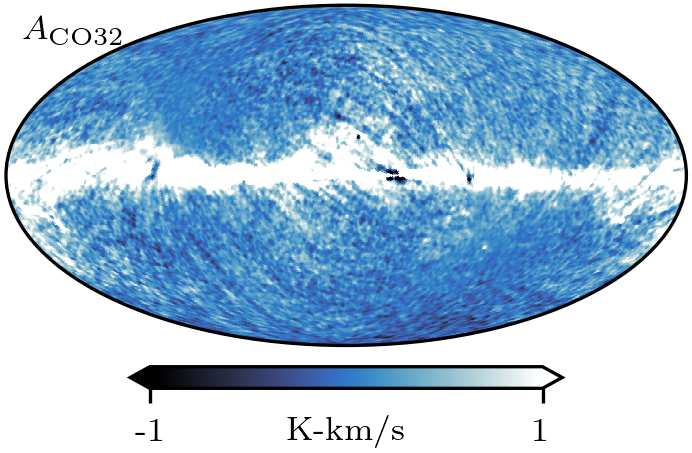

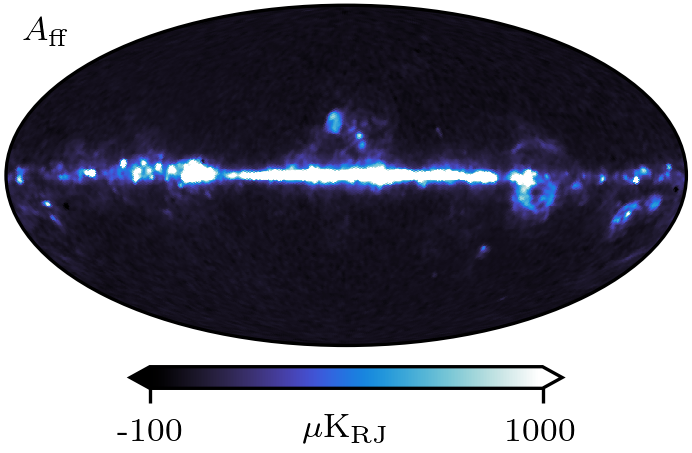

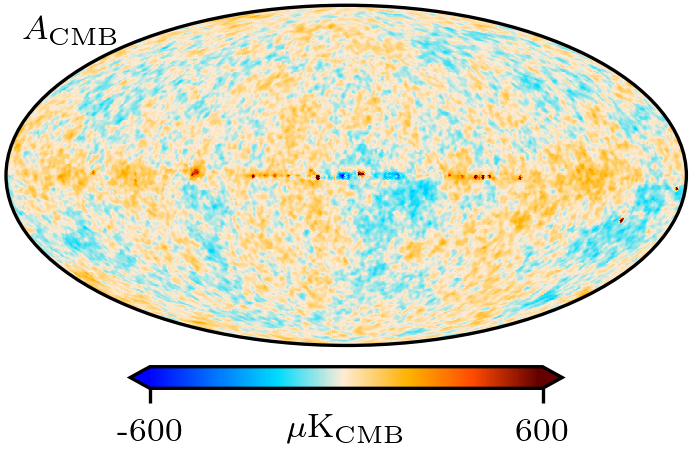

In [68]:
plt_kwargs={"fontsize":{"cbar_label":8,"cbar_tick_label":8},
            "width":2.5}

plt_kwargs_ncb={"fontsize":{"cbar_label":8,"cbar_tick_label":8},
            "width":2.35,'cbar':False}
# dust_titles=['Cold dust', 'Hot dust','Nearby dust',r'$H_\alpha$ dust']
# dust_titles_nl=['Cold \n dust', 'Hot \n dust','Nearby \n dust',r'$H_\alpha$ \n dust']
# dust_cmap=['Reds_r','Reds_r','Reds_r','Blues']
# dust_maxc=[500,500,300,0]
# dust_minc=[0,0,20,-50]

# i=0
# hp.projview(dust_maps[i],cmap=dust_cmap[i],min=dust_minc[i],max=dust_maxc[i],llabel=dust_titles[i],**plt_kwargs)
# plt.savefig(dust_names[i][1:]+'map.pdf')

# i=1
# hp.projview(dust_maps[i],cmap=dust_cmap[i],min=dust_minc[i],max=dust_maxc[i],llabel=dust_titles[i],**plt_kwargs)
# plt.savefig(dust_names[i][1:]+'map.pdf')

# i=2
# hp.projview(dust_maps[i],cmap=dust_cmap[i],min=dust_minc[i],max=dust_maxc[i],llabel=dust_titles_nl[i],**plt_kwargs)
# plt.savefig(dust_names[i][1:]+'map.pdf')

# i=3
# hp.projview(dust_maps[i],cmap=dust_cmap[i],min=dust_minc[i],max=dust_maxc[i],llabel=dust_titles[i],**plt_kwargs)
# plt.savefig(dust_names[i][1:]+'map.pdf')

i=0
hp.projview(fg_maps_plotres[i],unit=fg_units[i],cmap=fg_cmap[i],min=fg_minc[i],max=fg_maxc[i],llabel=fg_titles_nl[i],**plt_kwargs_ncb)
plt.savefig(fg_names[i]+'_map_nc.pdf')

i=1
hp.projview(fg_maps_plotres[i],unit=fg_units[i],cmap=fg_cmap[i],min=fg_minc[i],max=fg_maxc[i],llabel=fg_titles_nl[i],**plt_kwargs_ncb)
plt.savefig(fg_names[i]+'_map_nc.pdf')

i=2
hp.projview(fg_maps_plotres[i],unit=fg_units[i],cmap=fg_cmap[i],min=fg_minc[i],max=fg_maxc[i],llabel=fg_titles_nl[i],**plt_kwargs_ncb)
plt.savefig(fg_names[i]+'_map_nc.pdf')

# i=0
# hp.projview(fg_maps_plotres[i],unit=fg_units[i],cmap=fg_cmap[i],min=fg_minc[i],max=fg_maxc[i],llabel=fg_titles_nl[i],**plt_kwargs)
# plt.savefig(fg_names[i]+'_map.pdf')

# i=1
# hp.projview(fg_maps_plotres[i],unit=fg_units[i],cmap=fg_cmap[i],min=fg_minc[i],max=fg_maxc[i],llabel=fg_titles_nl[i],**plt_kwargs)
# plt.savefig(fg_names[i]+'_map.pdf')

# i=2
# hp.projview(fg_maps_plotres[i],unit=fg_units[i],cmap=fg_cmap[i],min=fg_minc[i],max=fg_maxc[i],llabel=fg_titles_nl[i],**plt_kwargs)
# plt.savefig(fg_names[i]+'_map.pdf')



# i=3
# hp.projview(fg_maps_plotres[i],unit=fg_units[i],cmap=fg_cmap[i],min=fg_minc[i],max=fg_maxc[i],llabel=fg_titles_nl[i],**plt_kwargs)
# plt.savefig(fg_names[i]+'_map.pdf')

# i=4
# hp.projview(fg_maps_plotres[i],unit=fg_units[i],cmap=fg_cmap[i],min=fg_minc[i],max=fg_maxc[i],llabel=fg_titles_nl[i],**plt_kwargs)
# plt.savefig(fg_names[i]+'_map.pdf')

In [27]:
# plt_kwargs_res={"override_plot_properties":{"cbar_pad":0.025,'cbar_label_pad': -6},
#             "width":6.5,"fontsize":{"cbar_label":6,"cbar_tick_label":8,"title":10}}
# # "fontsize":{"cbar_label":6,"cbar_tick_label":6}

# pltv=0
# for i in range(len(fg_maps_plotres)):
#     hp.projview(fg_maps_plotres[i],llabel=fg_titles[i],
#                 max=fg_maxc[i],min=fg_minc[i],cmap=fg_cmap[i],sub=(2,3,pltv+1),
#                 unit=fg_units[i])
#     pltv+=1




# plt.subplots_adjust(hspace=0.1, wspace=0.06)
# plt.savefig('foregrounds_plotres.pdf')

In [28]:
# fg_maps.append(hp.smoothing(fg_maps[0],fwhm=np.deg2rad(1)))
# fg_maps.append(hp.smoothing(fg_maps[1],fwhm=np.deg2rad(1)))
# fg_maps.append(hp.smoothing(fg_maps[2],fwhm=np.deg2rad(1)))

# i=5
# hp.projview(fg_maps[i],cmap=fg_cmap[i],min=fg_minc[i],max=fg_maxc[i],llabel=fg_titles_nl[i],**plt_kwargs)
# plt.savefig(fg_names[i]+'_smmap.pdf')

# i=6
# hp.projview(fg_maps[i],cmap=fg_cmap[i],min=fg_minc[i],max=fg_maxc[i],llabel=fg_titles_nl[i],**plt_kwargs)
# plt.savefig(fg_names[i]+'_smmap.pdf')

# i=7
# hp.projview(fg_maps[i],cmap=fg_cmap[i],min=fg_minc[i],max=fg_maxc[i],llabel=fg_titles_nl[i],**plt_kwargs)
# plt.savefig(fg_names[i]+'_smmap.pdf')

In [23]:
chi_map=hp.read_map(dust_fil+str(fiducial)+'/chisq'+fil)

# chisq_mask=np.where(chi_map<10000,1,0)
# hp.mollview(chisq_mask);plt.show()

# hp.write_map('chi_mask.fits',chisq_mask,overwrite=True)

# chisq_mask_2048=hp.ud_grade(chisq_mask,2048)
# chisq_mask_2048[chisq_mask_2048>0.95]=1
# chisq_mask_2048[chisq_mask_2048<=0.95]=0
# hp.mollview(chisq_mask_2048);plt.show()

# chisq_mask_1024=hp.ud_grade(chisq_mask,1024)
# chisq_mask_1024[chisq_mask_1024>0.95]=1
# chisq_mask_1024[chisq_mask_1024<=0.95]=0
# hp.mollview(chisq_mask_1024);plt.show()
# chisq_mask_small=np.where(chi_map<1000000,1,0)
# hp.mollview(chisq_mask_small);plt.show()
# chisq_mask_0016=hp.ud_grade(chisq_mask_small,16)
# chisq_mask_0016[chisq_mask_0016>0.95]=1
# chisq_mask_0016[chisq_mask_0016<=0.95]=0
# hp.mollview(chisq_mask_0016);plt.show()

# chisq_mask_0064=hp.ud_grade(chisq_mask,64)
# chisq_mask_0064[chisq_mask_0064>0.95]=1
# chisq_mask_0064[chisq_mask_0064<=0.95]=0
# hp.mollview(chisq_mask_0064);plt.show()
# hp.write_map('chisq_mask_0064.fits',chisq_mask_0064,overwrite=True)

# hp.write_map('chisq_mask_2048.fits',chisq_mask_2048,overwrite=True)
# hp.write_map('chisq_mask_1024.fits',chisq_mask_1024,overwrite=True)
# hp.write_map('chisq_mask_0016.fits',chisq_mask_0016,overwrite=True)

chisq_mask_2048=hp.read_map('chisq_mask_2048.fits')
chisq_mask_1024=hp.read_map('chisq_mask_1024.fits')
chisq_mask_0016=hp.read_map('chisq_mask_0016.fits')
chisq_mask_0064=hp.read_map('chisq_mask_0064.fits')
chisq_mask=hp.read_map('chi_mask.fits')


# co21=hp.smoothing(hp.read_map('/mn/stornext/u3/raelynsu/d23hfi/data/HFI_CompMap_CO-Type1_2048_R2.00_CO21.fits'),fwhm=np.deg2rad(30/60)) #greater than 15?
# co_mask=co21<3

# co_mask_1024=hp.ud_grade(co_mask,1024)
# co_mask_1024[co_mask_1024>0.95]=1
# co_mask_1024[co_mask_1024<=0.95]=0

# hp.write_map('co_mask.fits',co_mask)
# hp.write_map('co_mask_1024.fits',co_mask_1024)

co_mask_1024=hp.read_map('co_mask_1024.fits')
co_mask=hp.read_map('co_mask.fits') #nside 2048


mask_co_1=hp.read_map('mask_co1_n256.fits')
mask_co_0064=hp.ud_grade(mask_co_1,64)
mask_co_0064[mask_co_0064>0.95]=1
mask_co_0064[mask_co_0064<=0.95]=0
# hp.mollview(mask_co_0064)

In [ ]:
# hp.projview(chisq_mask_0064*mask_co_0064,cmap='binary_r',title=None,cbar=None);plt.show()
# hp.projview(chisq_mask_0016 * firas_mask,cmap='binary_r',title=None,cbar=None);plt.show()

In [20]:
# cold_dust_10_2048=downgrade(dust_maps[0],5,10,2048)
# cold_dust_16p2_1024=downgrade(dust_maps[0],5,16.2,1024)
# cold_dust_420_0016=downgrade(dust_maps[0],5,420,16)
# # cold_dust_420_0016_2=downgrade_ud(dust_maps[0],5,420,16)
# cold_dust_30_512=downgrade(dust_maps[0],5,30,512)
# cold_dust_7p5_512=downgrade(dust_maps[0],5,7.5,512)
# hot_dust_420_0016=downgrade(dust_maps[1],5,420,16)
# hot_dust_420_0016_2=downgrade_ud(dust_maps[1],5,420,16)
# hot_dust_10_2048=downgrade(dust_maps[1],5,10,2048)

# cold_dust_16p2_0064=downgrade(dust_maps[0],5,16.2,64)
# hi4pi_16p2_0064=downgrade(Himap,16.2,16.2,64)

# hp.write_map('cold_dust_16p2_0064.fits',cold_dust_16p2_0064)
# hp.write_map('hi4pi_16p2_0064.fits',hi4pi_16p2_0064)
# hp.write_map('cold_dust_10_2048.fits',cold_dust_10_2048,overwrite=True)
# hp.write_map('cold_dust_16p2_1024.fits',cold_dust_16p2_1024,overwrite=True)
# hp.write_map('cold_dust_420_0016.fits',cold_dust_420_0016,overwrite=True)
# hp.write_map('cold_dust_30_512.fits',cold_dust_30_512,overwrite=True)
# hp.write_map('hot_dust_420_0016.fits',hot_dust_420_0016,overwrite=True)
# hp.write_map('cold_dust_7p5_512.fits',cold_dust_7p5_512,overwrite=True)
# hp.write_map('hot_dust_10_2048.fits',hot_dust_10_2048,overwrite=True)

cold_dust_10_2048=hp.read_map('cold_dust_10_2048.fits')
cold_dust_16p2_1024=hp.read_map('cold_dust_16p2_1024.fits')
cold_dust_420_0016=hp.read_map('cold_dust_420_0016.fits')
cold_dust_30_512=hp.read_map('cold_dust_30_512.fits')
cold_dust_7p5_512=hp.read_map('cold_dust_7p5_512.fits')
hot_dust_420_0016=hp.read_map('hot_dust_420_0016.fits')
hot_dust_10_2048=hp.read_map('hot_dust_10_2048.fits')
cold_dust_16p2_0064=hp.read_map('cold_dust_16p2_0064.fits')
hi4pi_16p2_0064=hp.read_map('hi4pi_16p2_0064.fits')

In [ ]:
# hp.mollview(apply_mask(dust_maps[2],chisq_mask_2048),title=None,cbar=None,cmap='RdBu_r',max=100,min=-100)
# plt.savefig('Animate/near_dust_10_2048_anim.pdf')

In [ ]:
# hp.mollview(apply_mask(cold_dust_10_2048,chisq_mask_2048),title=None,cbar=None,cmap='RdBu_r',max=100,min=-100)
# plt.savefig('Animate/cold_dust_10_2048_anim.pdf')
# hp.mollview(apply_mask(cold_dust_16p2_1024,chisq_mask_1024),title=None,cbar=None,cmap='RdBu_r',max=100,min=-100)
# plt.savefig('Animate/cold_dust_16p2_1024_anim.pdf')
# hp.mollview(apply_mask(cold_dust_420_0016,chisq_mask_0016*firas_mask),title=None,cbar=None,cmap='RdBu_r',max=100,min=-100)
# plt.savefig('Animate/cold_dust_420_0016_anim.pdf')
# hp.mollview(apply_mask(cold_dust_30_512,dame_mask*chisq_mask),title=None,cbar=None,cmap='RdBu_r',max=100,min=-100)
# plt.savefig('Animate/cold_dust_30_512_anim.pdf')
# hp.mollview(apply_mask(cold_dust_7p5_512,dame_mask*chisq_mask),title=None,cbar=None,cmap='RdBu_r',max=100,min=-100)
# plt.savefig('Animate/cold_dust_7p5_512_anim.pdf')
# hp.mollview(apply_mask(hot_dust_420_0016,chisq_mask_0016*firas_mask),title=None,cbar=None,cmap='RdBu_r',max=100,min=-100)
# plt.savefig('Animate/hot_dust_420_0016_anim.pdf')
# hp.mollview(apply_mask(hot_dust_10_2048,chisq_mask_2048),title=None,cbar=None,cmap='RdBu_r',max=100,min=-100)
# plt.savefig('Animate/hot_dust_10_2048_anim.pdf')
# hp.mollview(apply_mask(Himap,chisq_mask_1024),min=5e20,max=1e21,title=None,cmap='Reds',cbar=None)
# plt.savefig('Animate/Himap_anim.pdf')
# hp.mollview(apply_mask(dame_co,dame_mask*chisq_mask),max=5,min=-5,title=None,cmap='RdBu_r',cbar=None)
# plt.savefig('Animate/dame_co_anim.pdf')
# hp.mollview(apply_mask(firas_cii,firas_mask*chisq_mask_0016),max=20,min=-20,title=None,cmap='RdBu_r',cbar=None)
# plt.savefig('Animate/firas_cii_anim.pdf')

In [ ]:
# hp.mollview(hot_dust_420_0016,max=150,min=0);plt.show()
# hp.mollview(cold_dust_420_0016,max=150,min=0);plt.show()
# hp.mollview(cold_dust_10_2048,max=150,min=0);plt.show()
# hp.mollview(cold_dust_16p2_1024,max=150,min=0);plt.show()
# hp.mollview(cold_dust_30_512,max=150,min=0);plt.show()
# hp.mollview(cold_dust_7p5_512,max=150,min=0);plt.show()


In [ ]:
cold_hi4pi_corr,cold_hi4pi_corr_map=calcCorr(cold_dust_16p2_1024,Himap,mask=chisq_mask_1024)
cold_hi4pi_corr2,cold_hi4pi_corr_map2=calcCorr(cold_dust_16p2_0064,hi4pi_16p2_0064,mask=chisq_mask_0064)
hot_cii_corr,hot_cii_corr_map=calcCorr(hot_dust_420_0016,firas_cii,mask=chisq_mask_0016*firas_mask)
cold_co_corr,cold_co_corr_map=calcCorr(cold_dust_30_512,dame_co,mask=dame_mask*chisq_mask)
cold_near_corr,cold_near_corr_map=calcCorr(cold_dust_10_2048,dust_maps[2],mask=chisq_mask_2048)
hot_near_corr,hot_near_corr_map=calcCorr(hot_dust_10_2048,dust_maps[2],mask=chisq_mask_2048)
print(cold_hi4pi_corr,cold_hi4pi_corr2,hot_cii_corr,cold_co_corr,cold_near_corr,hot_near_corr)
# 0.9295546310450951 0.9414809390055134 0.5803886365084211 0.6307566994191534 0.5003007107083859

0.9287726336768174 0.9422284390530709 0.9253809697136505 0.5813492661744052 0.6315132844538356 0.5059020373856651


In [ ]:
# plt.scatter(cold_dust_30_512[dame_mask*chisq_mask==1],dame_co[dame_mask*chisq_mask==1],alpha=0.5,marker='.')
# plt.xlabel(r'Cold Dust, $A_\mathrm{C}$, [$\mu \mathrm{K}_\mathrm{RJ}$]')
# plt.ylabel(r'CO, Dame (K Km/s)')
# # plt.savefig('cold_co_corr.pdf')

In [ ]:
# plt.scatter(cold_dust_16p2_1024[chisq_mask_1024==1],Himap[chisq_mask_1024==1],alpha=0.2,marker=',')
# plt.xlabel(r'Cold Dust, $A_\mathrm{C}$, [$\mu \mathrm{K}_\mathrm{RJ}$]')
# plt.ylabel('HI4PI, Column density')
# plt.savefig('cold_hi4pi_corr.pdf')

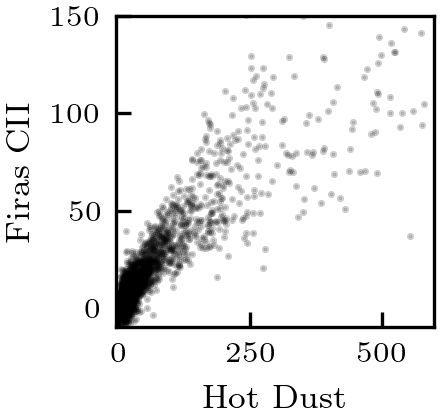

In [40]:
# One-column A&A figure size (in inches)
fig, ax = plt.subplots(figsize=(1.75, 1.6))

ax.scatter(
    hot_dust_420_0016[chisq_mask_0016 * firas_mask == 1],
    firas_cii[chisq_mask_0016 * firas_mask == 1],
    alpha=0.2,
    marker='.',
    s=2.0,          # slightly larger for print visibility
    c='k'
)

ax.set_xlabel(
    r'Hot Dust',
    fontsize=8
)
ax.set_ylabel(
    r'Firas CII',
    fontsize=8
)
ax.set_xlim(-5,600)
ax.set_ylim(-10,150)

ax.tick_params(labelsize=7)

# ax.set_aspect('equal', adjustable='box')

plt.tight_layout()
plt.savefig('hot_cii_corr_sm.pdf')


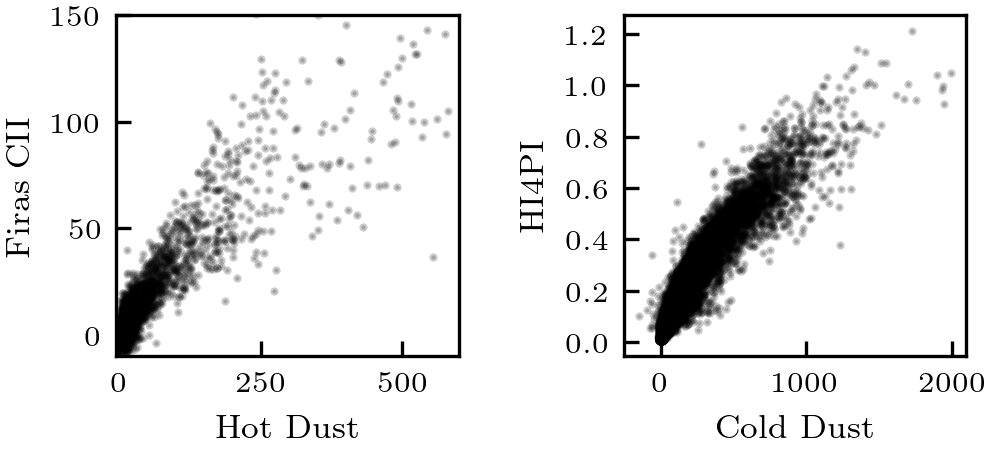

In [58]:
# One-column A&A figure size (in inches)
fig, ax = plt.subplots(1,2,figsize=(3.5, 1.7))

ax[1].plot(
    cold_dust_16p2_0064[chisq_mask_0064 * mask_co_0064 == 1],
    hi4pi_16p2_0064[chisq_mask_0064 * mask_co_0064 == 1] / 1e22,'.',
    alpha=0.2,
    ms=2.0,          # slightly larger for print visibility
    c='k',
    rasterized=True
)

ax[1].set_xlabel(
    r'Cold Dust',
    fontsize=8
)
ax[1].set_ylabel(
    # r'HI4PI,'+'\n'+ r'Column density ($\times 10^{22}$)',
    r'HI4PI',
    fontsize=8
)

ax[1].tick_params(labelsize=7)
ax[1].set_yticks([0.0, 0.2,0.4,0.6,0.8,1.0,1.2])
# ax.set_aspect('equal', adjustable='box')

ax[0].plot(
    hot_dust_420_0016[chisq_mask_0016 * firas_mask == 1],
    firas_cii[chisq_mask_0016 * firas_mask == 1],'.',
    alpha=0.2,
    ms=2.0,          # slightly larger for print visibility
    c='k'
)

ax[0].set_xlabel(
    r'Hot Dust',
    fontsize=8
)
ax[0].set_ylabel(
    r'Firas CII',
    fontsize=8
)
ax[0].set_xlim(-5,600)
ax[0].set_ylim(-10,150)

ax[0].tick_params(labelsize=7)

plt.tight_layout()
plt.savefig('dust_corr_sm.pdf')


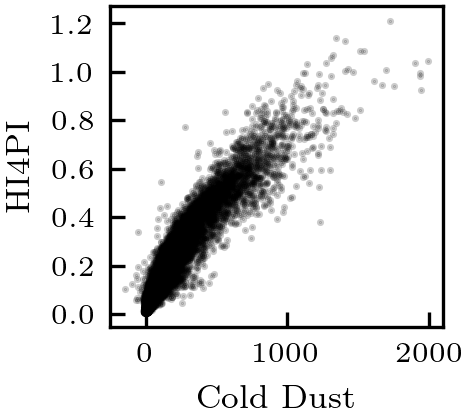

In [41]:
# One-column A&A figure size (in inches)
fig, ax = plt.subplots(figsize=(1.75, 1.6))

ax.scatter(
    cold_dust_16p2_0064[chisq_mask_0064 * mask_co_0064 == 1],
    hi4pi_16p2_0064[chisq_mask_0064 * mask_co_0064 == 1] / 1e22,
    alpha=0.2,
    marker='.',
    s=2.0,          # slightly larger for print visibility
    c='k'
)

ax.set_xlabel(
    r'Cold Dust',
    fontsize=8
)
ax.set_ylabel(
    # r'HI4PI,'+'\n'+ r'Column density ($\times 10^{22}$)',
    r'HI4PI',
    fontsize=8
)

ax.tick_params(labelsize=7)
ax.set_yticks([0.0, 0.2,0.4,0.6,0.8,1.0,1.2])
# ax.set_aspect('equal', adjustable='box')

plt.tight_layout()
plt.savefig('cold_hi4pi_corr_sm.pdf')


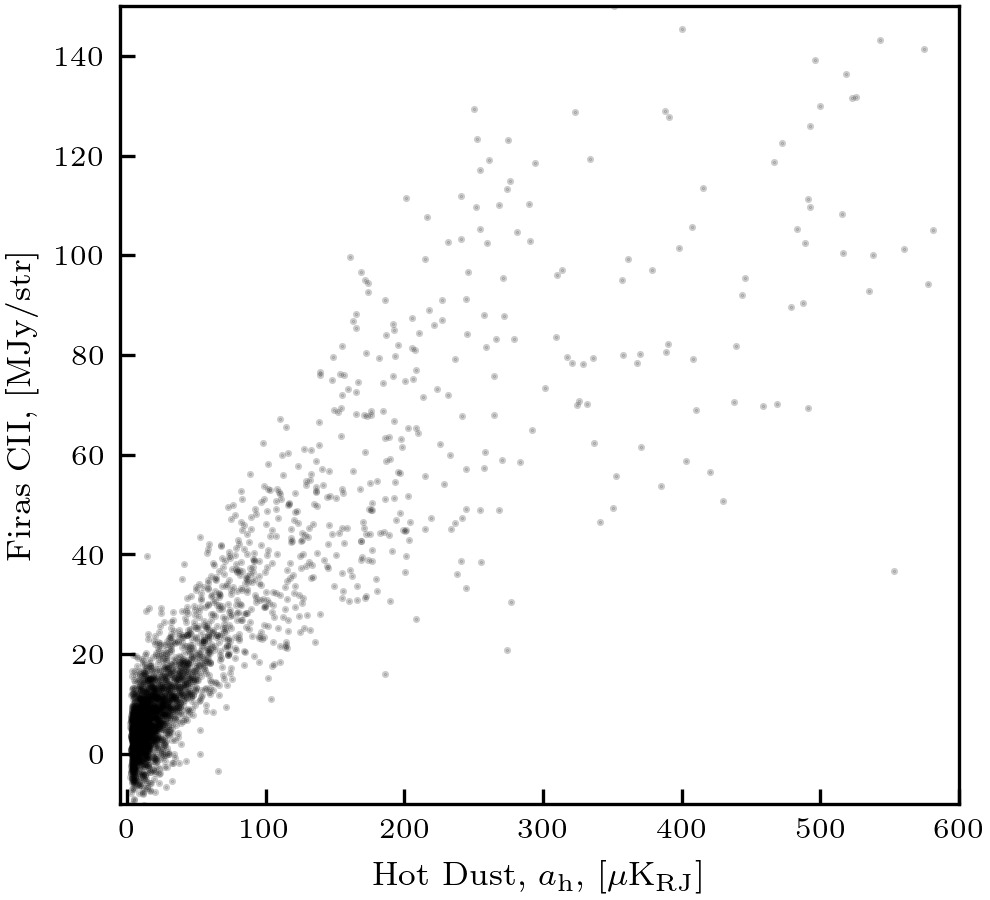

In [37]:
# One-column A&A figure size (in inches)
fig, ax = plt.subplots(figsize=(3.5, 3.2))

ax.scatter(
    hot_dust_420_0016[chisq_mask_0016 * firas_mask == 1],
    firas_cii[chisq_mask_0016 * firas_mask == 1],
    alpha=0.2,
    marker='.',
    s=2.0,          # slightly larger for print visibility
    c='k'
)

ax.set_xlabel(
    r'Hot Dust, $a_\mathrm{h}$, [$\mu \mathrm{K}_\mathrm{RJ}$]',
    fontsize=8
)
ax.set_ylabel(
    r'Firas CII, [$\mathrm{MJy}/\mathrm{str}$]',
    fontsize=8
)
ax.set_xlim(-5,600)
ax.set_ylim(-10,150)

ax.tick_params(labelsize=7)

# ax.set_aspect('equal', adjustable='box')

plt.tight_layout()
plt.savefig('hot_cii_corr.pdf')


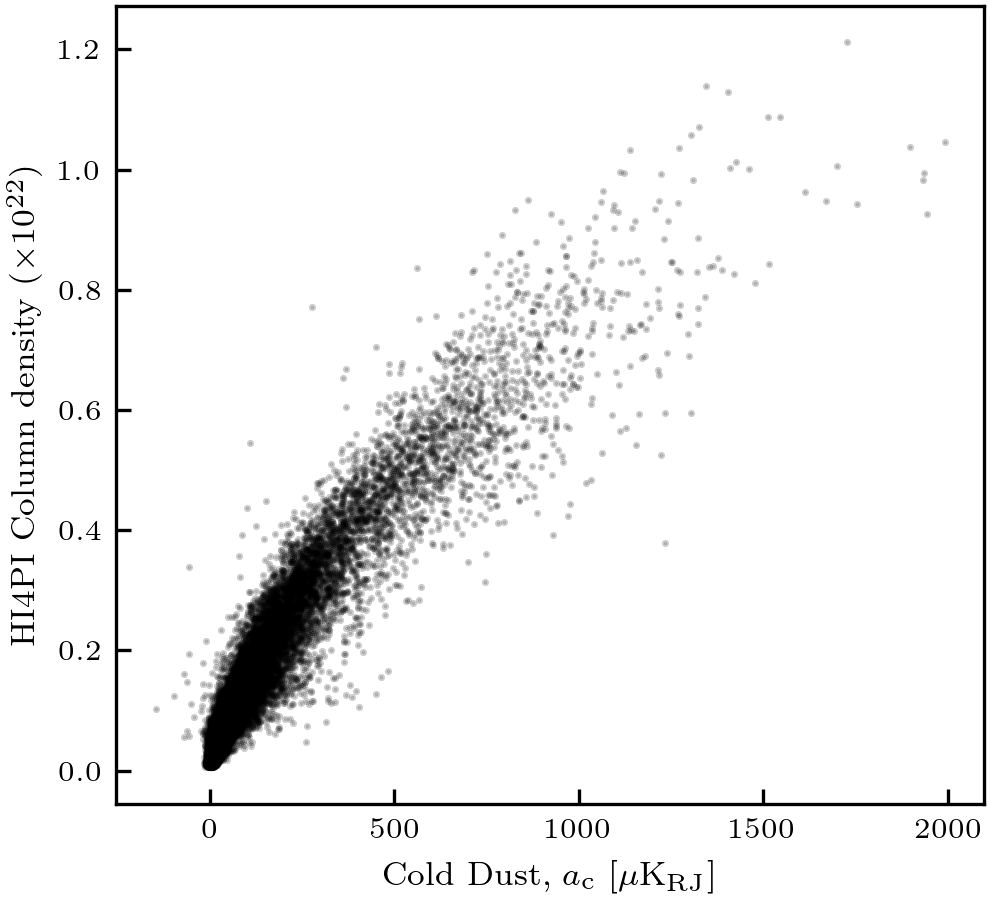

In [43]:
# One-column A&A figure size (in inches)
fig, ax = plt.subplots(figsize=(3.5, 3.2))

ax.scatter(
    cold_dust_16p2_0064[chisq_mask_0064 * mask_co_0064 == 1],
    hi4pi_16p2_0064[chisq_mask_0064 * mask_co_0064 == 1] / 1e22,
    alpha=0.2,
    marker='.',
    s=2.0,          # slightly larger for print visibility
    c='k'
)

ax.set_xlabel(
    r'Cold Dust, $a_\mathrm{c}$ [$\mu \mathrm{K}_\mathrm{RJ}$]',
    fontsize=8
)
ax.set_ylabel(
    # r'HI4PI,'+'\n'+ r'Column density ($\times 10^{22}$)',
    r'HI4PI Column density ($\times 10^{22}$)',
    fontsize=8
)

ax.tick_params(labelsize=7)
ax.set_yticks([0.0, 0.2,0.4,0.6,0.8,1.0,1.2])
# ax.set_aspect('equal', adjustable='box')

plt.tight_layout()
plt.savefig('cold_hi4pi_corr.pdf')


In [ ]:
# plt.scatter(cold_dust_16p2_0064[chisq_mask_0064*mask_co_0064==1],hi4pi_16p2_0064[chisq_mask_0064*mask_co_0064==1]/1e22,alpha=0.2,marker='.',s=0.75,c='k')
# plt.xlabel(r'Cold Dust, $a_\mathrm{c}$, [$\mu \mathrm{K}_\mathrm{RJ}$]')
# plt.ylabel(r'HI4PI, Column density ($\times 10^{22}$)')
# # plt.savefig('cold_hi4pi_corr.pdf')

In [ ]:
# plt.scatter(cold_dust_16p2_1024[chisq_mask_1024==1],Himap[chisq_mask_1024==1],alpha=0.2,marker='.',s=0.1)
# plt.xlabel(r'Cold Dust, $A_\mathrm{C}$, [$\mu \mathrm{K}_\mathrm{RJ}$]')
# plt.ylabel('HI4PI, Column density')
# # plt.savefig('cold_hi4pi_corr.pdf')


In [ ]:
# plt.scatter(cold_dust_10_2048[chisq_mask_2048==1],dust_maps[2][chisq_mask_2048==1],alpha=0.5,marker='.')
# # plt.scatter(cold_dust_420_0016[firas_mask==1],firas_cii[firas_mask==1],alpha=0.5,marker='.')
# plt.xlabel(r'Cold Dust, $A_\mathrm{C}$, [$\mu \mathrm{K}_\mathrm{RJ}$]')
# plt.ylabel(r'Nerby Dust, $A_\mathrm{near}$, [$\mu \mathrm{K}_\mathrm{RJ}$]')

In [ ]:
# plt.scatter(hot_dust_420_0016[firas_mask*chisq_mask_0016==1],firas_cii[firas_mask*chisq_mask_0016==1],alpha=0.5,marker='.',label='Hot')
# plt.scatter(cold_dust_420_0016[firas_mask*chisq_mask_0016==1],firas_cii[firas_mask*chisq_mask_0016==1],alpha=0.5,marker='.',label='Cold')
# plt.xlabel('Dust')
# plt.ylabel('Firas CII')
# plt.legend()

In [ ]:
# ttkwargs={"alpha":0.5,"marker":'.'}
# plotTT(cold_dust_420_0016[firas_mask*chisq_mask_0016==1],firas_cii[firas_mask*chisq_mask_0016==1],labely=r'FIRAS CII',labelx=r'Cold Dust, $A_\mathrm{C}$, [$\mu\mathrm{K}_\mathrm{RJ}$]',mask=firas_mask,**ttkwargs)

# plt.scatter(cold_dust_420_0016[(firas_mask*chisq_mask_0016)==1],firas_cii[(firas_mask*chisq_mask_0016)==1],alpha=0.5,marker='.')
# plt.xlabel(r'Cold Dust, $A_\mathrm{C}$, [$\mu\mathrm{K}_\mathrm{RJ}$]')
# plt.ylabel(r'FIRAS CII')

In [ ]:
# ttkwargs={"alpha":0.5,"marker":'.'}
# plt.scatter(hot_dust_420_0016[(firas_mask)==1],firas_cii[(firas_mask)==1],alpha=0.5,marker='.')
# plt.xlabel(r'Hot Dust, $A_\mathrm{H}$, [$\mu\mathrm{K}_\mathrm{RJ}$]')
# plt.ylabel(r'FIRAS CII')

In [ ]:
# ttkwargs={"alpha":0.5,"marker":'.'}
# plt.scatter(hot_dust_420_0016[(firas_mask*chisq_mask_0016)==1],firas_cii[(firas_mask*chisq_mask_0016)==1],alpha=0.5,marker='.')
# plt.xlabel(r'Hot Dust, $A_\mathrm{H}$, [$\mu\mathrm{K}_\mathrm{RJ}$]')
# plt.ylabel(r'FIRAS CII')

In [ ]:
# hp.mollview(dame_co_masked,cmap='RdBu_r',min=-1,max=1)